# Pre-Start Procedures

## If Running In Colab - Run Below Block First

In [1]:
# if running in colab, this block chooses tf 2.0:
try:
  # %tensorflow_version only exists in Colab.
  %tensorflow_version 2.x
except Exception:
    pass

## Import Statements

In [1]:
# customary imports:
import tensorflow as tf
assert '2.' in tf.__version__  # make sure you're using tf 2.0
import numpy as np
import matplotlib.pyplot as plt
import math
import string
import pandas as pd
import sklearn
import skimage
import cv2 as cv
import os
import datetime
import scipy
from skimage.morphology import reconstruction
from skimage import exposure
import scipy.io as sio
import h5py
import random
import shutil
import PIL
import imageio
import pydot 
import graphviz
import plotly.graph_objects as go
import preprocess_crop
from pathlib import Path
from tensorflow.keras import backend as K
from PIL import Image
from keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.layers import Dense, Flatten, Conv2D
from tensorflow.keras import Model
#from keras.utils import CustomObjectScope
from mpl_toolkits.mplot3d import Axes3D
print('Tensorflow version: ' + tf.__version__)
%matplotlib inline
%load_ext tensorboard

Using TensorFlow backend.


Tensorflow version: 2.0.0


In [2]:
device_name = tf.test.gpu_device_name()
if not tf.test.is_gpu_available():
    raise SystemError('GPU device not found')
print('Found GPU at: {}'.format(device_name))

Found GPU at: /device:GPU:0


## If Running In Colab - Run the Next Two Blocks

In [3]:
# Load the Drive helper and mount
from google.colab import drive

# This will prompt for authorization.
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [7]:
os.chdir('/content/drive/Shared drives/BME 590L - ML in Imaging - Final Project/Final Project')

print("Current Working Directory is : " + os.getcwd())

Current Working Directory is : /content/drive/Shared drives/BME 590L - ML in Imaging - Final Project/Final Project


# Data Preprocessing - Do not run if data folders already established

## Function to Convert .mat folder into Another File Format

In [2]:
# Import Statements
from data_preprocessing_utils import convert_MAP

In [3]:
raw_directory = os.path.join(os.getcwd(), 'raw_data')
MIN_SHAPE = (128,128)
ENDPOINT_FOLDER_NAME = 'converted_data'
converted_dir = convert_MAP(raw_directory, ENDPOINT_FOLDER_NAME, MIN_SHAPE,
                            file_format = '.npy', search_keys = ['map_532'])

Min Size Not Met: Datapoint Rejected -> E:\Duke\Semester 1 - Fall 2019\Research Lab\PAM_Deep_Learning_Undersampling_Publication\Code\raw_data\190309_brain  6_Image3.mat
Min Size Not Met: Datapoint Rejected -> E:\Duke\Semester 1 - Fall 2019\Research Lab\PAM_Deep_Learning_Undersampling_Publication\Code\raw_data\190309_brain  6_Image4.mat
Min Size Not Met: Datapoint Rejected -> E:\Duke\Semester 1 - Fall 2019\Research Lab\PAM_Deep_Learning_Undersampling_Publication\Code\raw_data\20190508_thinnedskull_Epi_by 2    3_Image1.mat
No Data to Meet Search Key Requirements: Datapoint Rejected -> E:\Duke\Semester 1 - Fall 2019\Research Lab\PAM_Deep_Learning_Undersampling_Publication\Code\raw_data\reslt_OR_1 (5).mat
No Data to Meet Search Key Requirements: Datapoint Rejected -> E:\Duke\Semester 1 - Fall 2019\Research Lab\PAM_Deep_Learning_Undersampling_Publication\Code\raw_data\reslt_OR_1 (36).mat
No Data to Meet Search Key Requirements: Datapoint Rejected -> E:\Duke\Semester 1 - Fall 2019\Research L

## Function to Process Data by Denoising and Increasing Contrast

In [ ]:
# Import Statements:
from data_preprocessing_utils import data_clean_func
from data_preprocessing_utils import data_cleaning

In [3]:
input_dir_name = 'converted_data'
#dir_name = 'test_data'
input_data_dir = os.path.join(os.getcwd(), input_dir_name)
print('Starting Data Cleaning...')
data_cleaning(input_dir = input_data_dir, output_dir_name = 'cleaned_data',
                  output_file_format ='.tiff', delete_previous = True)
print('Ending Data Cleaning')

Starting Data Cleaning...
Ending Data Cleaning


## Function to Seperate Folder into Subfolder of /training /validation and /testing

In [6]:
# Import Statements:
from data_preprocessing_utils import data_seperation

In [7]:
input_dir = 'cleaned_data'
dataset_percentages = (80, 10, 10)
print('Starting Data Seperation...')
train_dir, val_dir, test_dir = data_seperation(input_dir, dataset_percentages, 
                                               delete_previous = True, file_format = '.tif', 
                                               scale = 2**16)
print('Ending Data Seperation...')

Starting Data Seperation...
Ending Data Seperation...


### Code Block to Show How Much of Data has been Placed in various Subfolders (train/val/test)

In [8]:
print('Length of raw_data directory = '+str(len(os.listdir('raw_data'))))
print('Length of converted_data directory = '+str(len(os.listdir('converted_data'))))
print('Rejected Files = ' + str(len(os.listdir('raw_data')) - len(os.listdir('converted_data'))))
print('Length of cleaned_data directory = '+str(len(os.listdir('cleaned_data'))))
print('Length of training directory = '+str(len(os.listdir(train_dir))))
print('Length of validation directory = '+str(len(os.listdir(val_dir))))
print('Length of test directory = '+str(len(os.listdir(test_dir))))

Length of raw_data directory = 391
Length of converted_data directory = 294
Rejected Files = 97
Length of cleaned_data directory = 294
Length of training directory = 235
Length of validation directory = 30
Length of test directory = 29


# Data Loading

## Padding Training Data and Adding Downsampled Image as Channel

In [96]:
# Import Statements:
from standardize_dir_utils import pad_img_and_add_down_channel
from standardize_dir_utils import standardize_dir

Original Image Shape = (224, 224)
Padded Image Shape = (224, 224, 3)


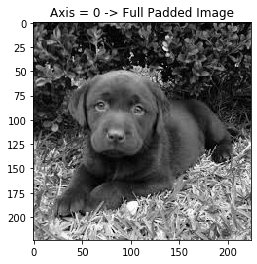

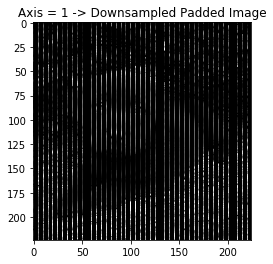


Downsampled Image Non-Zero Pixel % = 0.20085299744897958



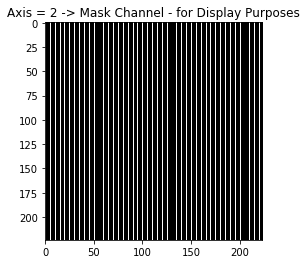

In [103]:
'''
# TESTING
img = np.array(imageio.imread('puppy.jpg'))
if len(img.shape)>2:
    img = np.mean(img, axis = 2)
img = img/np.max(img)
#img = img[14:210,:113]
#img = np.hstack((img[:,:], img))
print('Original Image Shape = '+str(img.shape))
padded_multi_chan_image = pad_img_and_add_down_channel(img, downsample_axis = 'both', 
                                                       downsample_ratio = [0,5], shape = (224,224))
print('Padded Image Shape = '+str(padded_multi_chan_image.shape))
plt.imshow(padded_multi_chan_image[:,:,0], cmap = 'gray')
plt.title('Axis = 0 -> Full Padded Image')
plt.show()
plt.imshow(padded_multi_chan_image[:,:,1], cmap = 'gray')
plt.title('Axis = 1 -> Downsampled Padded Image')
plt.show()
print('\n'+'Downsampled Image Non-Zero Pixel % = '+str(np.mean(padded_multi_chan_image[..., 1]>0))+'\n')
plt.imshow(padded_multi_chan_image[:,:,2], cmap = 'gray')
plt.title('Axis = 2 -> Mask Channel - for Display Purposes')
plt.show()
'''

In [11]:
input_dir = 'data/train/input'
STANDARD_IMAGE_SHAPE = (128,128,1)
total_train_image_pool = standardize_dir(input_dir = input_dir, downsample_axis = 'x', downsample_ratio = [0,5], 
                                               standard_shape = STANDARD_IMAGE_SHAPE, file_format = '.tif')
print('total_train_image_pool = ' + str(total_train_image_pool))

total_train_image_pool = 235


In [12]:
input_dir = 'data/val/input'
STANDARD_IMAGE_SHAPE = (128,128,1)
total_val_image_pool = standardize_dir(input_dir = input_dir, downsample_axis = 'x', downsample_ratio = [0,5], 
                                             standard_shape = STANDARD_IMAGE_SHAPE, file_format = '.tif')
print('total_val_image_pool = ' + str(total_val_image_pool))

total_val_image_pool = 30


In [13]:
input_dir = 'data/test/input'
STANDARD_IMAGE_SHAPE = (128,128,1)
total_test_image_pool = standardize_dir(input_dir = input_dir, downsample_axis = 'x', downsample_ratio = [0,5], 
                                                 standard_shape = STANDARD_IMAGE_SHAPE, file_format = '.tif')
print('total_test_image_pool = ' + str(total_test_image_pool))

total_test_image_pool = 29


# Model Testing and Training - Run after this point if restarting kernel

## Data Loader and Augmentation

In [12]:
def preprocess_function(image, prob = 0.1, max_shift = 0.10, lower = 1.0, upper = 1.25, seed=7):
    img = image.copy()
    #img = add_rand_contrast(img, lower, upper, prob, seed=seed)
    img = add_gaussian_noise(img, std = 0.1, prob = prob, seed=seed)
    '''
    img = tf.keras.preprocessing.image.random_zoom(img,zoom_range=(0.8,2),row_axis=0,col_axis=1,channel_axis=2,
                                                   fill_mode='nearest',cval=0.0,interpolation_order=3)
    '''
    img = exposure.rescale_intensity(img, in_range = 'image', out_range = (0.0,1.0))
    #print(img.shape)
    return img

In [13]:
def preprocess_function_valtest(image):
    img = image.copy()
    img = exposure.rescale_intensity(img, in_range='image', out_range=(0.0,1.0))
    return img

In [14]:
def add_gaussian_noise(batch, mean_val = 0.0, std = 0.1, prob = 0.1, seed = None):
    rand_var = tf.random.uniform(shape = [1], seed=seed).numpy()[0]
    batch_and_noise = batch
    if rand_var < prob:
        noise = tf.random.normal(shape=tf.shape(batch), mean=mean_val, 
                                 stddev=std, dtype=tf.float32, seed=seed)
        batch_and_noise = tf.math.add(batch,noise)
        batch_and_noise = batch_and_noise.numpy()
    return batch_and_noise

In [15]:
# NOT USED -> but Thought It Might be Useful in the Future
def add_rand_bright_shift(batch, max_shift = 0.12, prob = 0.1, seed=None):
    # Equivalent to adjust_brightness() using a delta randomly
    # picked in the interval [-max_delta, max_delta) with a
    # given probability that this function is performed on an image
    rand_var = tf.random.uniform(shape = [1], seed=seed).numpy()[0]
    batch_and_bright_shift = batch
    if rand_var < prob:
        batch_and_bright_shift = tf.image.random_brightness(image=batch, max_delta=max_shift, 
                                                            seed=seed)
        batch_and_bright_shift = batch_and_bright_shift.numpy()
    return batch_and_bright_shift

In [16]:
def add_rand_contrast(batch, lower = 0.2, upper = 1.8, prob = 0.1, seed=None):
    # For each channel, this Op computes the mean of the image pixels in the channel 
    # and then adjusts each component x of each pixel to (x - mean) * contrast_factor + mean
    # with a given probability that this function is performed on an image
    rand_var = tf.random.uniform(shape = [1],seed=seed).numpy()[0]
    batch_and_rand_contrast = batch
    if rand_var < prob:
        batch_and_rand_contrast = tf.image.random_contrast(image=batch, lower=lower, 
                                                           upper=upper, seed=seed)
        batch_and_rand_contrast = batch_and_rand_contrast.numpy()
    return batch_and_rand_contrast

In [17]:
STANDARD_IMAGE_SHAPE = (128,128,1) # See Above Section to Verify Shape
MIN_SHAPE = (STANDARD_IMAGE_SHAPE[0],STANDARD_IMAGE_SHAPE[1])
BATCH_SIZE = 16
train_dir = 'data_1/train' #'data/train'
val_dir = 'data_1/val' #'data/val'
test_dir = 'data_1/test' #'data/test'

In [18]:
data_gen_args_train = dict(horizontal_flip=True,
                           vertical_flip = True,
                           rotation_range=20,
                           width_shift_range=0.2,
                           height_shift_range=0.2,
                           shear_range=0.2,
                           fill_mode = 'constant',
                           cval = 0,
                           preprocessing_function = preprocess_function,
                           dtype='float32')
train_datagen = ImageDataGenerator(**data_gen_args_train)
data_gen_args_test_and_val = dict(preprocessing_function = preprocess_function_valtest)
test_and_val_datagen = ImageDataGenerator(**data_gen_args_test_and_val)
seed = 7
tf.random.set_seed(seed)
# Flow From Directory Generators
train_generator = train_datagen.flow_from_directory(train_dir,
                                                    target_size=MIN_SHAPE,
                                                    batch_size=BATCH_SIZE,
                                                    class_mode=None,
                                                    ####################
                                                    # Monkey Patch - preprocess_crop.py
                                                    interpolation = 'lanczos:random',
                                                    ####################
                                                    color_mode='rgb',
                                                    shuffle = True, 
                                                    seed=seed)

validation_generator = test_and_val_datagen.flow_from_directory(val_dir,
                                                                target_size=MIN_SHAPE,
                                                                batch_size=BATCH_SIZE,
                                                                class_mode=None,
                                                                ####################
                                                                # Monkey Patch - preprocess_crop.py
                                                                interpolation = 'lanczos:center',
                                                                ####################
                                                                color_mode='rgb',
                                                                shuffle = True, 
                                                                seed=seed)
test_generator = test_and_val_datagen.flow_from_directory(test_dir,
                                                          target_size=MIN_SHAPE,
                                                          batch_size=BATCH_SIZE,
                                                          class_mode=None,
                                                          ####################
                                                          # Monkey Patch - preprocess_crop.py
                                                          interpolation = 'lanczos:center', 
                                                          ####################
                                                          color_mode='rgb', 
                                                          shuffle = False,
                                                          seed=seed)

Found 235 images belonging to 1 classes.
Found 30 images belonging to 1 classes.
Found 29 images belonging to 1 classes.


In [19]:
def custom_generator_wrapper(gen):
    for data in gen:
        orig_img = data[...,0] # target
        down_img = data[...,1] # input
        # Third channel is empty and only there for compatibility
        yield down_img[..., None], orig_img[..., None]

## Model Definition for U-Net

In [20]:
'''
# Model Subclassing with Physical Layer (Legacy)
from UNet_model_simp_with_phys_layer import UNet_model_simp_with_phys_layer
'''
'''
# Model Subclassing without Physical Layer
from UNet_model_simp import UNet_model_simp
'''

# USING FUNCTIONAL API

#from UNet_model_simp_func import getModel
#from ResUNet import getModel
#from ICL_ResUNet import getModel
from FD_UNet import getModel

from model_utils import model_loss
from model_utils import PSNR
from model_utils import SSIM
from model_utils import KLDivergence
from model_utils import SavingMetric

### Hyperparameters

In [21]:
EPOCHS = 125 #500 #3500
FILTERS = 64
INITIAL_LR = 0.001
ACTIVATION = 'elu'
KERNEL_SIZE = 3 # 3x3 kernel
AUGMENTATIONS = 10
B1 = 0.99
B2 = 0.01
B3 = 0.0
B4 = 0.0#1/3

### Compiling and Training Model

In [22]:
# Subclassed Model
#unet_model = UNet_model_simp(filters = FILTERS, kernel_size = KERNEL_SIZE, activation = ACTIVATION)

In [23]:
INPUT_SHAPE=STANDARD_IMAGE_SHAPE
# Functional API Model
unet_model = getModel(input_shape=INPUT_SHAPE, filters=FILTERS, kernel_size=KERNEL_SIZE, activation=ACTIVATION)

In [24]:
#unet_model = saved_model
#unet_model = best_unet_model
unet_model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate = INITIAL_LR, amsgrad=False),  # pick an optimizer
                   loss=model_loss(B1,B2, B4=B4),  # pick a loss
                   metrics=['mean_absolute_error', 'mean_squared_error', KLDivergence, SavingMetric, PSNR, SSIM])  # pick a metric to monitor

In [25]:
train_dir = 'data_1/train/input' #'data/train/input'
val_dir = 'data_1/val/input' #'data/val/input'
model_dir = 'model_dir'
delete_previous=True

if not os.path.exists(model_dir):
            os.mkdir(model_dir)
elif delete_previous == True:
            shutil.rmtree(model_dir)
            os.mkdir(model_dir)

my_callbacks = [tf.keras.callbacks.ModelCheckpoint(filepath = os.path.join(model_dir, 'saved_model.epoch_{epoch:02d}-SSIM_{val_SSIM:.5f}-PSNR_{val_PSNR:.5f}-metric_{val_SavingMetric:.5f}.h5'),
                                                   monitor='val_SavingMetric', verbose=0, 
                                                   save_best_only=True, save_weights_only=False, 
                                                   mode='min', save_freq='epoch')]
'''
logdir = "logs\\scalars\\" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
if not os.path.exists(logdir):
    os.mkdir(logdir)
else:
    shutil.rmtree(logdir)
    os.mkdir(logdir)
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=logdir, histogram_freq=1)
my_callbacks.append(tensorboard_callback)
%tensorboard --logdir logs/scalars
'''

history = unet_model.fit_generator(custom_generator_wrapper(train_generator),
                                   steps_per_epoch=AUGMENTATIONS*np.ceil(len(os.listdir(train_dir))/BATCH_SIZE),
                                   epochs=EPOCHS,
                                   callbacks=my_callbacks, 
                                   validation_data=custom_generator_wrapper(validation_generator),
                                   validation_steps=np.ceil(len(os.listdir(val_dir))/BATCH_SIZE), 
                                   max_queue_size = 256,
                                   shuffle = True)

Epoch 1/125
300/300 [==============================] - 426s 1s/step - loss: 0.6436 - mean_absolute_error: 0.1239 - mean_squared_error: 0.0535 - KLDivergence: 0.1283 - SavingMetric: 0.8581 - PSNR: 17.5822 - SSIM: 0.2290 - val_loss: 0.4418 - val_mean_absolute_error: 0.1076 - val_mean_squared_error: 0.0210 - val_KLDivergence: 0.1152 - val_SavingMetric: 0.6814 - val_PSNR: 17.4670 - val_SSIM: 0.4063
Epoch 2/125
300/300 [==============================] - 388s 1s/step - loss: 0.3787 - mean_absolute_error: 0.0829 - mean_squared_error: 0.0130 - KLDivergence: 0.0446 - SavingMetric: 0.7613 - PSNR: 19.9299 - SSIM: 0.3140 - val_loss: 0.3806 - val_mean_absolute_error: 0.0861 - val_mean_squared_error: 0.0138 - val_KLDivergence: -0.0266 - val_SavingMetric: 0.5246 - val_PSNR: 19.1652 - val_SSIM: 0.5545
Epoch 3/125
300/300 [==============================] - 290s 967ms/step - loss: 0.3523 - mean_absolute_error: 0.0757 - mean_squared_error: 0.0112 - KLDivergence: 0.0359 - SavingMetric: 0.7026 - PSNR: 20.8

### Tensorboard Launch

In [ ]:
#%tensorboard --logdir logs/scalars

### Load the Best Model From Model Dir

In [35]:
from model_utils import model_loss
from model_utils import PSNR
from model_utils import SSIM
from model_utils import KLDivergence
from model_utils import SavingMetric
print('Loading Best Model...')
model_dir = 'model_dir'
filename = os.listdir(model_dir)[-1]
directory = os.path.join(os.getcwd(), model_dir)
directory = os.path.join(directory, filename)
best_unet_model = tf.keras.models.load_model(directory, custom_objects={'model_loss':model_loss,'loss_func':model_loss(B1=0.99,B2=0.01, B4=1/3), 
                                                                        'PSNR':PSNR, 'SSIM':SSIM, 'KLDivergence':KLDivergence, 
                                                                        'SavingMetric':SavingMetric})
print('Done Loading Best Model(' + filename + ') from: ' + model_dir)

Loading Best Model...
Done Loading Best Model(saved_model.epoch_80-SSIM_0.67868-PSNR_21.09472-metric_0.39085.h5) from: model_dir


## Analysis of Model Training

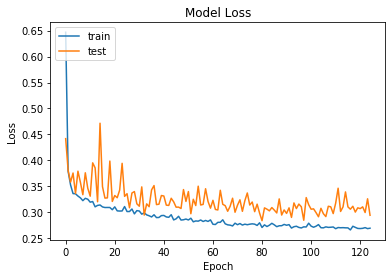

In [26]:
offset = 0
data1 = history.history['loss'][offset:]
epochs = range(offset,len(data1)+offset)
plt.plot(epochs, data1)
data2 = history.history['val_loss'][offset:]
plt.plot(epochs, data2)
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(["train", "test"], loc = "upper left")
#plt.xticks(epochs)
plt.show()

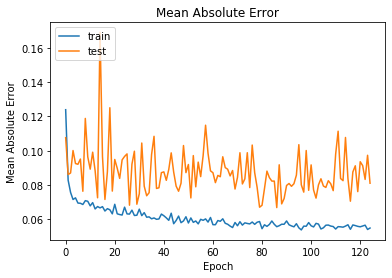

In [27]:
offset = 0
data1 = history.history['mean_absolute_error'][offset:]
epochs = range(offset,len(data1)+offset)
plt.plot(epochs, data1)
data2 = history.history['val_mean_absolute_error'][offset:]
plt.plot(epochs, data2)
plt.title('Mean Absolute Error')
plt.ylabel('Mean Absolute Error')
plt.xlabel('Epoch')
plt.legend(["train", "test"], loc = "upper left")
#plt.xticks(epochs)
plt.show()

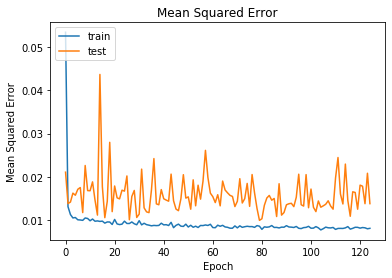

In [28]:
offset = 0
data1 = history.history['mean_squared_error'][offset:]
epochs = range(offset,len(data1)+offset)
plt.plot(epochs, data1)
data2 = history.history['val_mean_squared_error'][offset:]
plt.plot(epochs, data2)
plt.title('Mean Squared Error')
plt.ylabel('Mean Squared Error')
plt.xlabel('Epoch')
plt.legend(["train", "test"], loc = "upper left")
#plt.xticks(epochs)
plt.show()

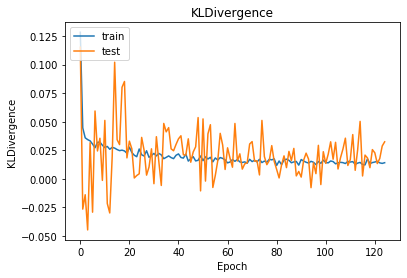

In [29]:
offset = 0
data1 = history.history['KLDivergence'][offset:]
epochs = range(offset,len(data1)+offset)
plt.plot(epochs, data1)
data2 = history.history['val_KLDivergence'][offset:]
plt.plot(epochs, data2)
plt.title('KLDivergence')
plt.ylabel('KLDivergence')
plt.xlabel('Epoch')
plt.legend(["train", "test"], loc = "upper left")
#plt.xticks(epochs)
plt.show()

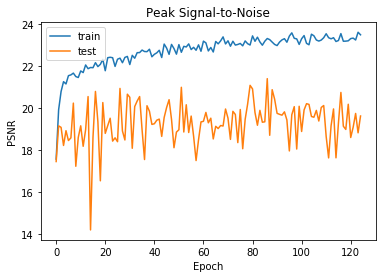

In [30]:
offset = 0
data1 = history.history['PSNR'][offset:]
epochs = range(offset,len(data1)+offset)
plt.plot(epochs, data1)
data2 = history.history['val_PSNR'][offset:]
plt.plot(epochs, data2)
plt.title('Peak Signal-to-Noise')
plt.ylabel('PSNR')
plt.xlabel('Epoch')
plt.legend(["train", "test"], loc = "upper left")
#plt.xticks(epochs)
plt.show()

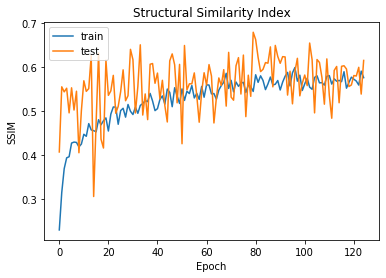

In [31]:
offset = 0
data1 = history.history['SSIM'][offset:]
epochs = range(offset,len(data1)+offset)
plt.plot(epochs, data1)
data2 = history.history['val_SSIM'][offset:]
plt.plot(epochs, data2)
plt.title('Structural Similarity Index')
plt.ylabel('SSIM')
plt.xlabel('Epoch')
plt.legend(["train", "test"], loc = "upper left")
#plt.xticks(epochs)
plt.show()

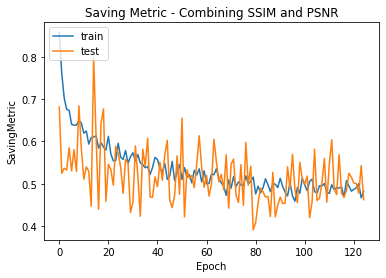

In [32]:
offset = 0
data1 = history.history['SavingMetric'][offset:]
epochs = range(offset,len(data1)+offset)
plt.plot(epochs, data1)
data2 = history.history['val_SavingMetric'][offset:]
plt.plot(epochs, data2)
plt.title('Saving Metric - Combining SSIM and PSNR')
plt.ylabel('SavingMetric')
plt.xlabel('Epoch')
plt.legend(["train", "test"], loc = "upper left")
#plt.xticks(epochs)
plt.show()

### Model Architecture

In [ ]:
unet_model.summary()

In [ ]:
tf.keras.utils.plot_model(unet_model, 'saved_model_UNet_0i-5j_down/unet_arch_TB.png', show_shapes=True, rankdir='TB', dpi=300)

## Save Model

### For Keras Subclassing

In [19]:
def save_history(history, output_dir):
    directory = os.path.join(os.getcwd(), output_dir)
    if not os.path.exists(directory):
        os.mkdir(directory)
    filepath = os.path.join(directory, 'history')
    np.savez(filepath, **history.history)

In [173]:
# Using Keras Subclassing
output_dir = 'saved_uni_down_80_patch_v2'
if not os.path.exists(os.path.join(os.getcwd(), output_dir)):
    print('Creating Directory...')
    os.mkdir(os.path.join(os.getcwd(), output_dir))
#unet_model.trainable = False
print('Saving Model...')
tf.keras.models.save_model(unet_model,
                           output_dir,
                           overwrite=True,
                           include_optimizer=True,
                           save_format='tf',
                           signatures=None,
                           options=None)
print('Saving History...')
save_history(history, output_dir)
print('Done Saving')

Instructions for updating:
If using Keras pass *_constraint arguments to layers.
INFO:tensorflow:Assets written to: saved_uni_down_80_patch_v2\assets


### For Functional API

In [26]:
def save_history(history, output_dir):
    directory = os.path.join(os.getcwd(), output_dir)
    if not os.path.exists(directory):
        os.mkdir(directory)
    filepath = os.path.join(directory, 'history')
    np.savez(filepath, **history.history)

In [27]:
# Using Functional API
output_dir = 'saved_model_FD_UNet_3i-7j_down'
filename = 'saved_model.h5'
if not os.path.exists(os.path.join(os.getcwd(), output_dir)):
    print('Creating Directory...')
    os.mkdir(os.path.join(os.getcwd(), output_dir))
else:
    print('Directory Already Exists...')
print('Saving Model...')
directory = os.path.join(os.getcwd(), output_dir)
directory = os.path.join(directory, filename)
unet_model.save(directory)
print('Saving History...')
save_history(history, output_dir)
print('Done Saving !!!')

Creating Directory...
Saving Model...
Saving History...
Done Saving !!!


## Load Model (only for prediction with Keras Subclassing)

### For Keras Subclassing

#### Copy and Paste Hyperparameters Used (From Text File)

In [31]:
def load_history_from_saved(directory):
    direct = os.path.join(os.getcwd(), directory)
    filepath = os.path.join(direct, 'history.npz')
    array = np.load(filepath, allow_pickle=True, fix_imports=True)
    return array

In [32]:
def show_history(hist, offset=50):
    data1 = history.history['loss'][offset:]
    epochs = range(offset,len(data1)+offset)
    plt.plot(epochs, data1)
    data2 = history.history['val_loss'][offset:]
    plt.plot(epochs, data2)
    plt.title('Model Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(["train", "test"], loc = "upper left")
    #plt.xticks(epochs)
    plt.show()
    
    data1 = history.history['mean_absolute_error'][offset:]
    epochs = range(offset,len(data1)+offset)
    plt.plot(epochs, data1)
    data2 = history.history['val_mean_absolute_error'][offset:]
    plt.plot(epochs, data2)
    plt.title('Mean Absolute Error')
    plt.ylabel('Mean Absolute Error')
    plt.xlabel('Epoch')
    plt.legend(["train", "test"], loc = "upper left")
    #plt.xticks(epochs)
    plt.show()
    
    data1 = history.history['mean_squared_error'][offset:]
    epochs = range(offset,len(data1)+offset)
    plt.plot(epochs, data1)
    data2 = history.history['val_mean_squared_error'][offset:]
    plt.plot(epochs, data2)
    plt.title('Mean Squared Error')
    plt.ylabel('Mean Squared Error')
    plt.xlabel('Epoch')
    plt.legend(["train", "test"], loc = "upper left")
    #plt.xticks(epochs)
    plt.show()
    
    data1 = history.history['KLDivergence'][offset:]
    epochs = range(offset,len(data1)+offset)
    plt.plot(epochs, data1)
    data2 = history.history['val_KLDivergence'][offset:]
    plt.plot(epochs, data2)
    plt.title('KLDivergence')
    plt.ylabel('KLDivergence')
    plt.xlabel('Epoch')
    plt.legend(["train", "test"], loc = "upper left")
    #plt.xticks(epochs)
    plt.show()
    
    data1 = history.history['PSNR'][offset:]
    epochs = range(offset,len(data1)+offset)
    plt.plot(epochs, data1)
    data2 = history.history['val_PSNR'][offset:]
    plt.plot(epochs, data2)
    plt.title('Peak Signal-to-Noise')
    plt.ylabel('PSNR')
    plt.xlabel('Epoch')
    plt.legend(["train", "test"], loc = "upper left")
    #plt.xticks(epochs)
    plt.show()
    
    data1 = history.history['SSIM'][offset:]
    epochs = range(offset,len(data1)+offset)
    plt.plot(epochs, data1)
    data2 = history.history['val_SSIM'][offset:]
    plt.plot(epochs, data2)
    plt.title('Structural Similarity Index')
    plt.ylabel('SSIM')
    plt.xlabel('Epoch')
    plt.legend(["train", "test"], loc = "upper left")
    #plt.xticks(epochs)
    plt.show()

In [185]:
from UNet_model_simp import UNet_model_simp
EPOCHS = 500 #3500
FILTERS = 64#32
INITIAL_LR = 0.001
ACTIVATION = 'elu'
KERNEL_SIZE = 3 # 3x3 kernel

In [186]:
token = UNet_model_simp(filters = FILTERS, kernel_size = KERNEL_SIZE, activation = ACTIVATION)
token.compile(optimizer=tf.keras.optimizers.Adam(learning_rate = INITIAL_LR),  # pick an optimizer
              loss=token.loss_func,  # pick a loss
              metrics=['mean_absolute_error'])  # pick a metric to monitor
hist_tok = token.fit_generator(custom_generator_wrapper(train_generator),
                               steps_per_epoch=1,#np.ceil(len(os.listdir(train_dir))/ BATCH_SIZE),
                               epochs=1,
                               validation_data=custom_generator_wrapper(validation_generator),
                               validation_steps=1,#np.ceil(len(os.listdir(val_dir))/ BATCH_SIZE),
                               shuffle = True)

1/1 [==============================] - 4s 4s/step - loss: 1.1236 - mean_absolute_error: 1.1236 - val_loss: 0.2689 - val_mean_absolute_error: 0.2689


In [187]:
from UNet_model_simp import UNet_model_simp
from UNet_model_simp import UNet_DownBlock
from UNet_model_simp import UNet_UpBlock
from UNet_model_simp import Conv2D_BatchNorm
from UNet_model_simp import Upsample_Conv2D_BatchNorm
from model_utils import model_loss
from model_utils import PSNR
from model_utils import SSIM
print('Loading Model...')
custom_objects={'UNet_DownBlock' : UNet_DownBlock,
                'UNet_UpBlock' : UNet_UpBlock,
                'Conv2D_BatchNorm' : Conv2D_BatchNorm,
                'Upsample_Conv2D_BatchNorm' : Upsample_Conv2D_BatchNorm,
                'total_loss' : token.loss_func}
input_dir = 'saved_uni_down_80_patch_v2'
saved_model = tf.keras.models.load_model(input_dir, custom_objects = custom_objects, compile = False)
saved_model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate = INITIAL_LR),  # pick an optimizer
                    loss=token.loss_func,  # pick a loss
                    metrics=['mean_absolute_error', 'mean_squared_error', PSNR, SSIM])  # pick a metric to monitor
print('Done Loading Model from: ' + input_dir)

Loading Model...
Done Loading Model from: saved_uni_down_80_patch_v2


#### Load History From File

In [ ]:
input_dir = 'saved_uni_down_80_patch_v2'
saved_hist = load_history_from_saved(input_dir)

#### Show History

In [ ]:
show_history(saved_hist, offset=50)

### For Functional API - Best Model State

In [16]:
from model_utils import model_loss
from model_utils import PSNR
from model_utils import SSIM
from model_utils import KLDivergence
from model_utils import SavingMetric
print('Loading Model...')
input_dir = 'saved_model_FD_UNet_3i-7j_down\\best_models'
filename = os.listdir(input_dir)[-1]
directory = os.path.join(os.getcwd(), input_dir)
directory = os.path.join(directory, filename)
saved_model = tf.keras.models.load_model(directory, custom_objects={'model_loss':model_loss,'loss_func':model_loss(B1=0.99,B2=0.01), 
                                                                    'PSNR':PSNR, 'SSIM':SSIM, 'KLDivergence':KLDivergence, 
                                                                    'SavingMetric':SavingMetric})
print('Done Loading Best Model(' + filename + ') from: ' + input_dir)

Loading Model...
Done Loading Best Model(saved_model.epoch_93-SSIM_0.53825-PSNR_18.82697-metric_0.54262.h5) from: saved_model_FD_UNet_5i-10j_down


### For Functional API - Latest Model State

In [13]:
from model_utils import model_loss
from model_utils import PSNR
from model_utils import SSIM
from model_utils import KLDivergence
from model_utils import SavingMetric
print('Loading Model...')
input_dir = 'saved_model_FD_UNet_0i-5j_down'
filename = 'saved_model.h5'
directory = os.path.join(os.getcwd(), input_dir)
directory = os.path.join(directory, filename)
saved_model = tf.keras.models.load_model(directory, custom_objects={'model_loss':model_loss,'loss_func':model_loss(B1=0.99,B2=0.01), 
                                                                    'PSNR':PSNR, 'SSIM':SSIM, 'KLDivergence':KLDivergence, 
                                                                    'SavingMetric':SavingMetric})
print('Done Loading Latest Model ' + filename + ' from: ' + input_dir)

Loading Model...
Done Loading Latest Model saved_model.h5 from: saved_model_FD_UNet_0i-5j_down


#### Load History From File

In [ ]:
def load_history_from_saved(directory):
    direct = os.path.join(os.getcwd(), directory)
    filepath = os.path.join(direct, 'history.npz')
    array = np.load(filepath, allow_pickle=True, fix_imports=True)
    return array

In [ ]:
input_dir = 'saved_uni_down_80_patch_func'
saved_hist = load_history_from_saved(input_dir)

#### Show History

In [ ]:
def show_history(hist, offset=0):
    data1 = history.history['loss'][offset:]
    epochs = range(offset,len(data1)+offset)
    plt.plot(epochs, data1)
    data2 = history.history['val_loss'][offset:]
    plt.plot(epochs, data2)
    plt.title('Model Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(["train", "test"], loc = "upper left")
    #plt.xticks(epochs)
    plt.show()
    
    data1 = history.history['mean_absolute_error'][offset:]
    epochs = range(offset,len(data1)+offset)
    plt.plot(epochs, data1)
    data2 = history.history['val_mean_absolute_error'][offset:]
    plt.plot(epochs, data2)
    plt.title('Mean Absolute Error')
    plt.ylabel('Mean Absolute Error')
    plt.xlabel('Epoch')
    plt.legend(["train", "test"], loc = "upper left")
    #plt.xticks(epochs)
    plt.show()
    
    data1 = history.history['mean_squared_error'][offset:]
    epochs = range(offset,len(data1)+offset)
    plt.plot(epochs, data1)
    data2 = history.history['val_mean_squared_error'][offset:]
    plt.plot(epochs, data2)
    plt.title('Mean Squared Error')
    plt.ylabel('Mean Squared Error')
    plt.xlabel('Epoch')
    plt.legend(["train", "test"], loc = "upper left")
    #plt.xticks(epochs)
    plt.show()
    
    data1 = history.history['KLDivergence'][offset:]
    epochs = range(offset,len(data1)+offset)
    plt.plot(epochs, data1)
    data2 = history.history['val_KLDivergence'][offset:]
    plt.plot(epochs, data2)
    plt.title('KLDivergence')
    plt.ylabel('KLDivergence')
    plt.xlabel('Epoch')
    plt.legend(["train", "test"], loc = "upper left")
    #plt.xticks(epochs)
    plt.show()
    
    data1 = history.history['PSNR'][offset:]
    epochs = range(offset,len(data1)+offset)
    plt.plot(epochs, data1)
    data2 = history.history['val_PSNR'][offset:]
    plt.plot(epochs, data2)
    plt.title('Peak Signal-to-Noise')
    plt.ylabel('PSNR')
    plt.xlabel('Epoch')
    plt.legend(["train", "test"], loc = "upper left")
    #plt.xticks(epochs)
    plt.show()
    
    data1 = history.history['SSIM'][offset:]
    epochs = range(offset,len(data1)+offset)
    plt.plot(epochs, data1)
    data2 = history.history['val_SSIM'][offset:]
    plt.plot(epochs, data2)
    plt.title('Structural Similarity Index')
    plt.ylabel('SSIM')
    plt.xlabel('Epoch')
    plt.legend(["train", "test"], loc = "upper left")
    #plt.xticks(epochs)
    plt.show()
    
    offset = 0
    data1 = history.history['SavingMetric'][offset:]
    epochs = range(offset,len(data1)+offset)
    plt.plot(epochs, data1)
    data2 = history.history['val_SavingMetric'][offset:]
    plt.plot(epochs, data2)
    plt.title('Saving Metric - Combining SSIM and PSNR')
    plt.ylabel('SavingMetric')
    plt.xlabel('Epoch')
    plt.legend(["train", "test"], loc = "upper left")
    #plt.xticks(epochs)
    plt.show()

In [ ]:
show_history(saved_hist, offset=50)

## Analysis of Model Output/Results

In [36]:
predictions_curr = best_unet_model.predict_generator(custom_generator_wrapper(test_generator), steps = 1)
print(predictions_curr.shape)

(16, 128, 128, 1)


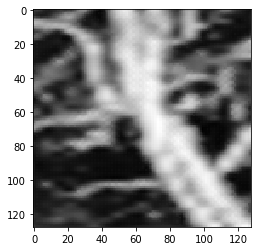

In [37]:
plt.imshow(predictions_curr[14,:,:,0], cmap = 'gray')
plt.show()

# Showing Results with Test Images:

### Downsampling the Image in testing/input directory

In [ ]:
# Import Statements:
from standardize_dir_utils import pad_img_and_add_down_channel
from standardize_dir_utils import standardize_dir

In [53]:
num_img = standardize_dir(input_dir = 'testing/input', downsample_axis = 'x', downsample_ratio = [0,5], 
                          standard_shape = (128,128,1), file_format = '.tif')

### Showing Results on Test Image

In [33]:
def preprocess_function_testing(image, shape = (128,128,1)):
    img = image.copy()
    #print(img.shape)
    img = exposure.rescale_intensity(img, in_range='image', out_range=(0.0,1.0))
    img = np.array(img, dtype = np.float32)
    #print(img.shape)
    #plt.imshow(img[:,:,0], cmap='gray')
    #plt.show()
    return img

In [34]:
data_gen_args_testing = dict(#featurewise_center=True,
                          #featurewise_std_normalization=True,
                          preprocessing_function = preprocess_function_testing)
testing_datagen = ImageDataGenerator(**data_gen_args_testing)

# Provide the same seed and keyword arguments to the fit and flow methods
testing_dir = 'testing'

testing_generator = testing_datagen.flow_from_directory(testing_dir,target_size=(128,128),
                                                        batch_size=1,class_mode=None,color_mode='rgb', shuffle = False)

Found 1 images belonging to 1 classes.


In [35]:
def custom_generator_wrapper(gen):
    for data in gen:
        orig_img = data[...,0] # target
        down_img = data[...,1] # input
        # Third channel is empty and only there for compatibility
        yield down_img[..., None], orig_img[..., None]

testing/input\brain_image_crop_1_128by128_pad.tif
(128, 128)


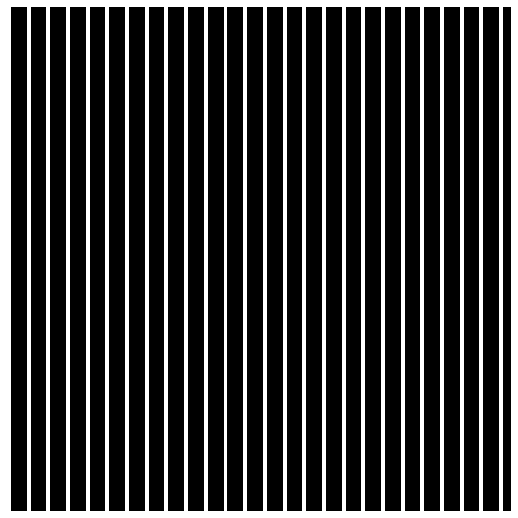

total elements in mask = 16384
total elements not downsampled = 3328.0
max value in mask = 1.0
min value in mask = 0.0
mean of mask = 0.203125


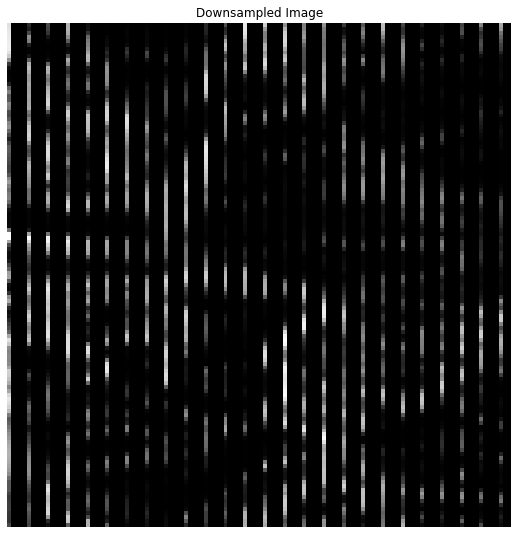

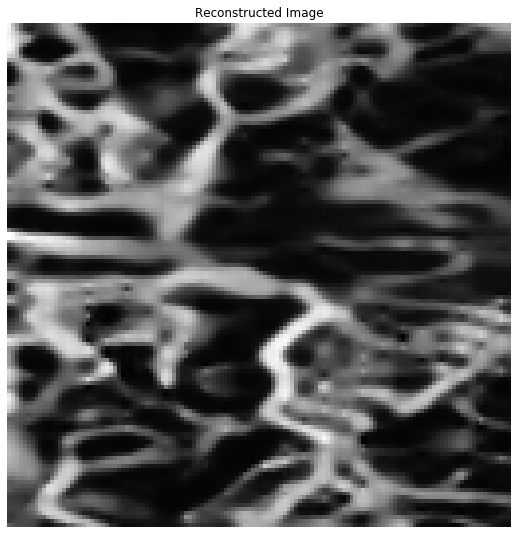

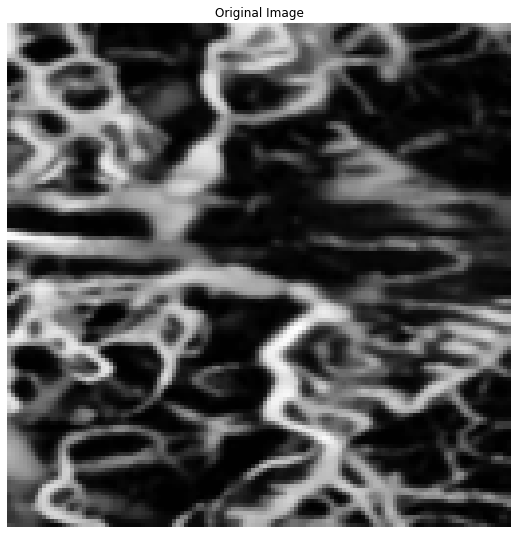

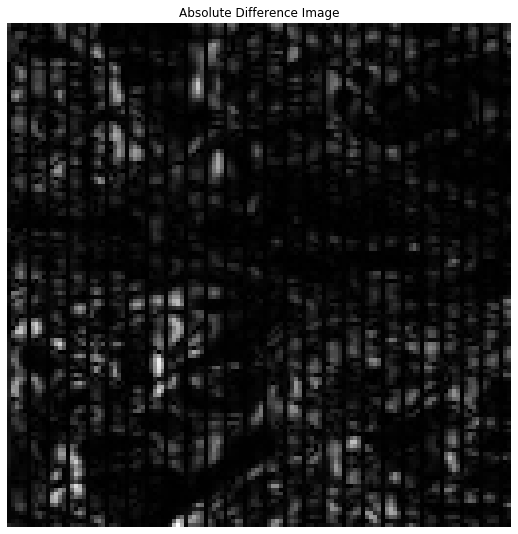

Mean Absolute Difference: 0.042911373
Max Absolute Difference: 0.5628783


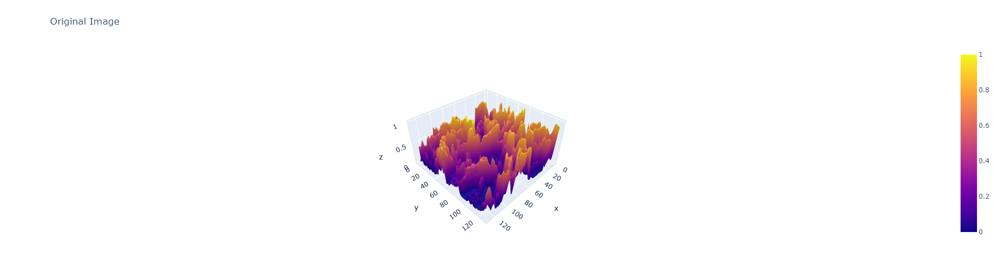

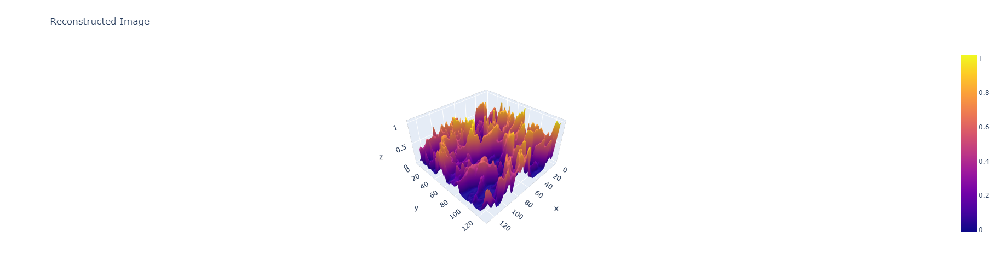

In [36]:
dir_name = 'testing/input'
saved_model = best_unet_model
file_list = os.listdir(dir_name)   
filename = os.fsdecode(file_list[0])
filepath = os.path.join(dir_name, filename)
print(filepath)
#filepath = 'testing/input/reslt_OR_7 (2)_index0_center_crop.tif'
img = np.array(imageio.imread(filepath))
orig_img = img[...,0]
down_img = img[...,1]
mask = img[...,2]
pred = saved_model.predict_generator(custom_generator_wrapper(testing_generator), steps=1)
image = pred[0,:,:,0]

figsize = (7,7)
# Create a figure of the right size with one axes that takes up the full figure
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
# Hide spines, ticks, etc.
ax.axis('off')

ax.imshow(mask, cmap = 'gray')
print(mask.shape)
plt.show()
print('total elements in mask = '+ str(np.sum(mask>-1)))
print('total elements not downsampled = '+str(np.sum(mask)))
print('max value in mask = '+str(np.max(mask)))
print('min value in mask = '+str(np.min(mask)))
print('mean of mask = '+str(np.mean(mask)))

fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(down_img, cmap = 'gray')
plt.title('Downsampled Image')
plt.show()

fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(image, cmap = 'gray')
plt.title('Reconstructed Image')
plt.show()

fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(orig_img, cmap = 'gray')
plt.title('Original Image')
plt.show()

fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(np.abs(orig_img - image), cmap = 'gray') #ax.imshow(skimage.util.invert(np.abs(image - img/np.max(img))), cmap = 'gray')
plt.title('Absolute Difference Image')
plt.show()
print('Mean Absolute Difference: ' + str(np.mean(np.abs(orig_img - image))))
print('Max Absolute Difference: ' + str(np.max(np.abs(orig_img - image))))

# xx, yy = np.mgrid[0:image.shape[0], 0:image.shape[1]]
# fig = plt.figure(figsize=figsize)
# ax = fig.gca(projection='3d')
# ax.plot_surface(xx, yy, image, rstride=1, cstride=1, cmap=plt.cm.gray,linewidth=2)
# ax.view_init(80, 30)
# plt.show()

# Interactive 3-D Plot
img = np.flip(orig_img, axis = 0)
sh_0, sh_1 = img.shape
x, y = np.linspace(1, sh_0, sh_0), np.linspace(1, sh_0, sh_1)
fig = go.Figure(data=[go.Surface(z=img, x=x, y=y)])
fig.update_layout(title='Original Image', autosize=False,
                  width=500, height=500,
                  scene = dict(aspectratio=dict(x=1, y=1, z=0.5)),
                  margin=dict(l=65, r=50, b=65, t=90))

fig.show()

# Interactive 3-D Plot
image = np.flip(image, axis = 0)
sh_0, sh_1 = image.shape
x, y = np.linspace(1, sh_0, sh_0), np.linspace(1, sh_0, sh_1)
fig = go.Figure(data=[go.Surface(z=image, x=x, y=y)])
fig.update_layout(title='Reconstructed Image', autosize=False,
                  width=500, height=500,
                  scene = dict(aspectratio=dict(x=1, y=1, z=0.5)),
                  margin=dict(l=65, r=50, b=65, t=90))
fig.show()

# Applying Model to Larger Images:

In [12]:
# Import Statements
import patchwork_alg
from patchwork_alg import expand_image
from patchwork_alg import fix_boundaries
from patchwork_alg import apply_model_patchwork

Directory:testing\input\brain_image_crop_1_128by128_pad.tif


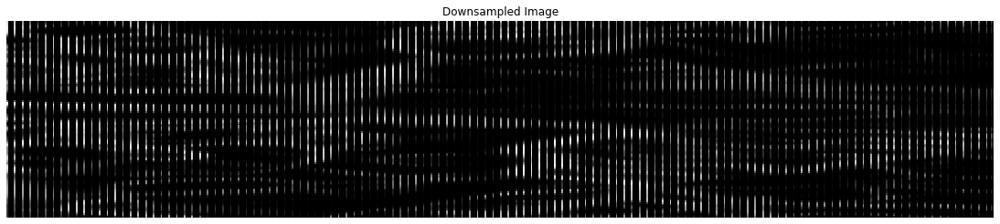

Augmented Shape: (128, 640)
20.2880859375 %


In [13]:
dir_name = 'testing\\input'
file_list = os.listdir(dir_name)   
filename = os.fsdecode(file_list[0])
filepath = os.path.join(dir_name, filename)
print('Directory:' + filepath)
#filepath = 'testing/input/reslt_OR_7 (2)_index0_center_crop.tif'
img = np.array(imageio.imread(filepath))
img = img[...,0]
full = expand_image(down_image = img, downsampling_ratio = [0,5], downsampling_axis = 'both')
figsize = (15,15)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(full, cmap = 'gray')
plt.title('Downsampled Image')
plt.show()
print('Augmented Shape: ' + str(full.shape))
print(str((np.sum(full>0)/(full.shape[0]*full.shape[1]))*100) + ' %')

Directory: testing\input\brain_image_crop_1_128by128_pad.tif


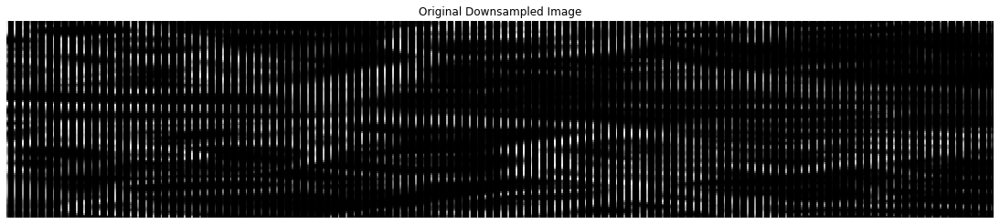

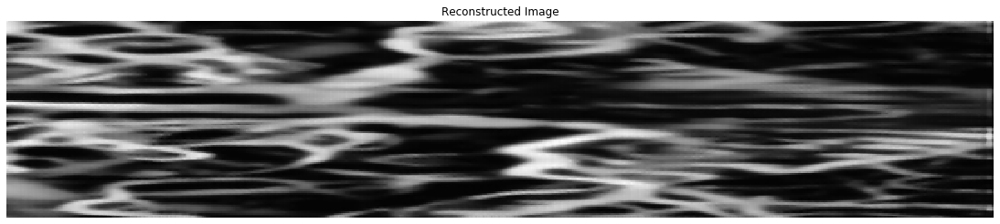

Augmented Shape: (128, 640)
20.2880859375 %


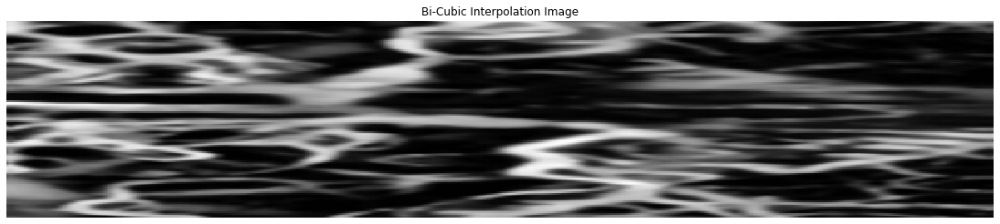

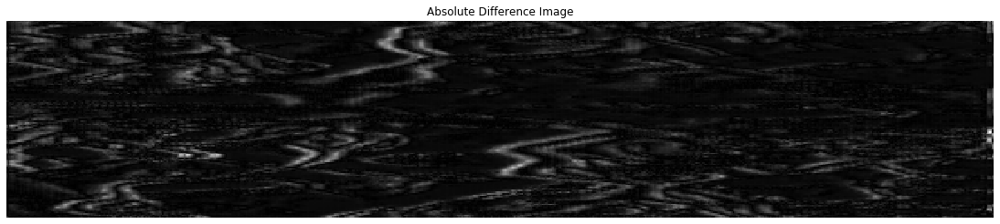

Mean Absolute Difference: 0.024715974287137243
Max Absolute Difference: 0.32969392629737


In [14]:
dir_name = 'testing\\input'
saved_model = best_unet_model
file_list = os.listdir(dir_name)   
filename = os.fsdecode(file_list[0])
filepath = os.path.join(dir_name, filename)
print('Directory: ' + filepath)
#filepath = 'testing/input/reslt_OR_7 (2)_index0_center_crop.tif'
orig_img = np.array(imageio.imread(filepath))
'''
# If using color images
if len(img.shape)>2:
    img = np.mean(img, axis = 2)
'''
img = orig_img[...,0]
img = exposure.rescale_intensity(img, in_range='image', out_range=(0.0,1.0))
img = np.pad(img, [(0, 0), (0, 0)], mode='constant')
figsize = (15,15)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
full = expand_image(down_image = img, downsampling_ratio = [1,5], downsampling_axis = 'both')
ax.imshow(full, cmap = 'gray')
plt.title('Original Downsampled Image')
plt.show()
full_image = apply_model_patchwork(saved_model, down_image = img, downsampling_ratio = [1,5], 
                                   downsampling_axis = 'both', shape_for_model = (128,128), buffer = 20)
figsize = (15,15)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(full_image, cmap = 'gray')
plt.title('Reconstructed Image')
plt.show()
print('Augmented Shape: ' + str(full.shape))
print(str((np.sum(full>0)/(full.shape[0]*full.shape[1]))*100) + ' %')

# COMPARISON TO INTERPOLATION:
# From https://scikit-image.org/docs/dev/api/skimage.transform.html#skimage.transform.warp
# and https://scikit-image.org/docs/dev/api/skimage.transform.html#skimage.transform.resize
i_expansion_ratio = 1
j_expansion_ratio = 5
interp_img = skimage.transform.resize(img, output_shape = (img.shape[0]*i_expansion_ratio,img.shape[1]*j_expansion_ratio), 
                                      order=3, mode='reflect', cval=0, clip=True, preserve_range=True, anti_aliasing=True, 
                                      anti_aliasing_sigma=None)
figsize = (15,15)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(interp_img, cmap = 'gray')
plt.title('Bi-Cubic Interpolation Image')
plt.show()

# DIFFERENCE IMAGE:
figsize = (15,15)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(np.abs(interp_img - full_image), cmap = 'gray')
plt.title('Absolute Difference Image')
plt.show()
print('Mean Absolute Difference: ' + str(np.mean(np.abs(interp_img - full_image))))
print('Max Absolute Difference: ' + str(np.max(np.abs(interp_img - full_image))))

Directory: testing\input\brain_image_crop_1_128by128_pad.tif


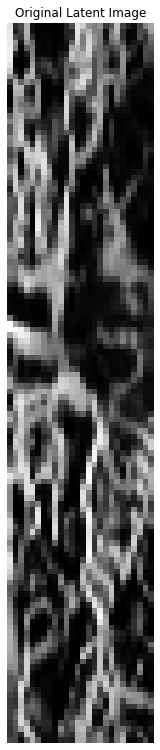

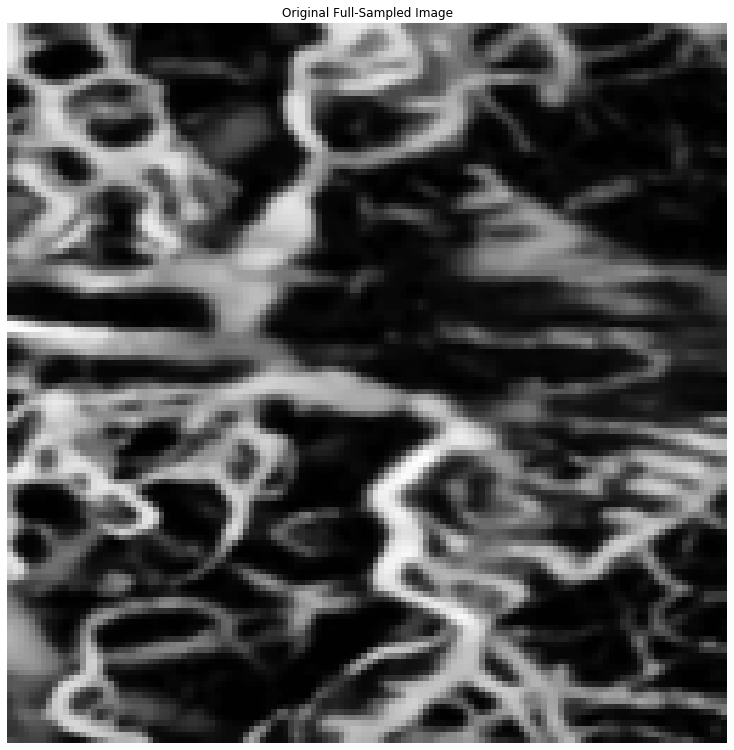

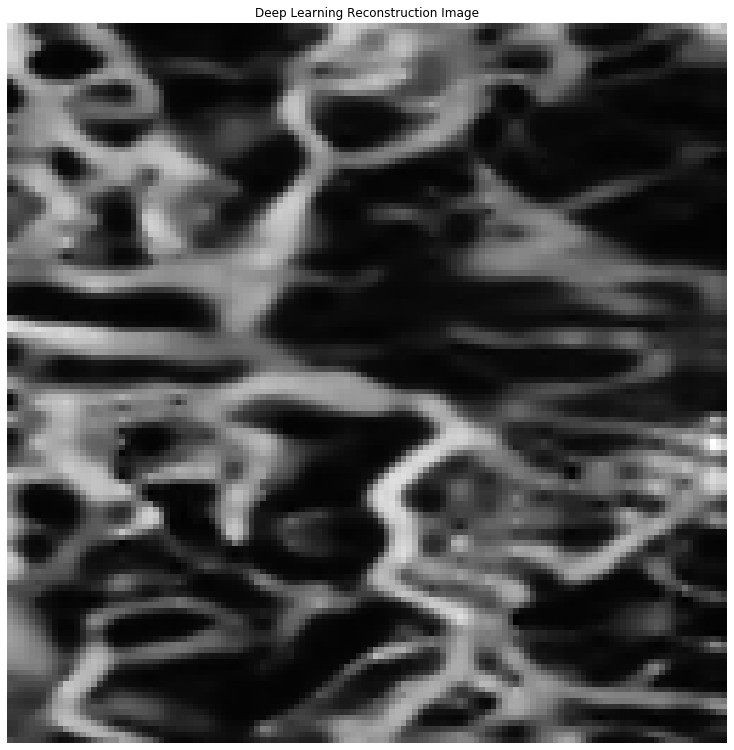

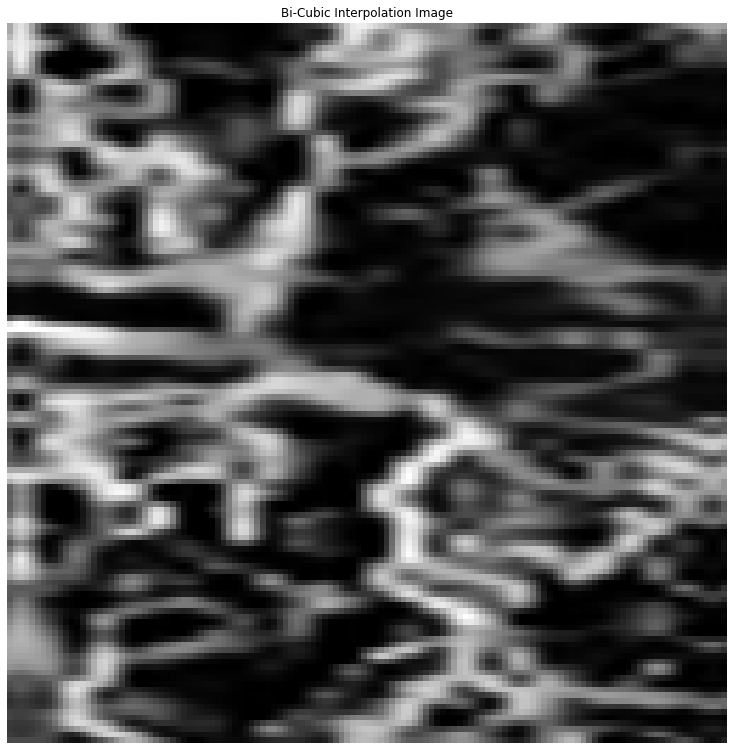

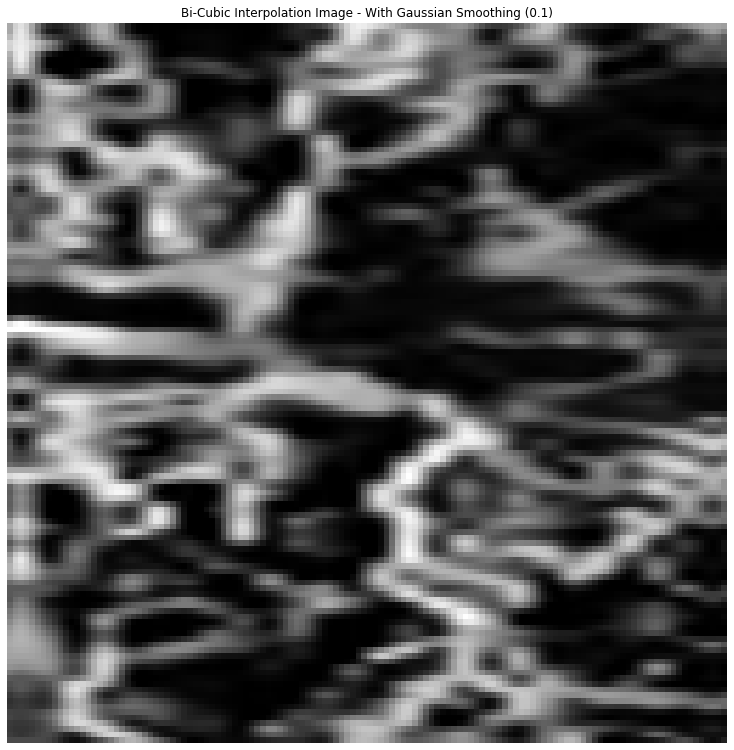

---------------------------------------
##########LIST OF STATISTICS:##########
---------------------------------------
COMPARISON OF PSNR:
Deep Learning: 21.6483
Bicubic Interp: 19.27721
COMPARISON OF SSIM:
Deep Learning: 0.8444987
Bicubic Interp: 0.78868335
COMPARISON OF MEAN ABSOLUTE ERROR:
Deep Learning: 0.05511927
Bicubic Interp: 0.066905364
COMPARISON OF MEAN SQUARED ERROR:
Deep Learning: 0.0068417923
Bicubic Interp: 0.01181079
COMPARISON OF KL DIVERGENCE:
Deep Learning: 0.033146158
Bicubic Interp: 0.019096494
COMPARISON OF MEAN SQUARED LOGARITHMIC ERROR:
Deep Learning: 0.0034522107
Bicubic Interp: 0.0063040997
COMPARISON OF LOG COSH ERROR:
Deep Learning: 0.0033951504
Bicubic Interp: 0.0058149975
COMPARISON OF POISSON LOSS:
Deep Learning: 0.5263643
Bicubic Interp: 0.540255


In [15]:
dir_name = 'testing\\input'
saved_model = best_unet_model
file_list = os.listdir(dir_name)   
filename = os.fsdecode(file_list[0])
filepath = os.path.join(dir_name, filename)
print('Directory: ' + filepath)
#filepath = 'testing/input/reslt_OR_7 (2)_index0_center_crop.tif'
orig_img = np.array(imageio.imread(filepath))
full_samp_img = exposure.rescale_intensity(orig_img[...,0], in_range='image', out_range=(0.0,1.0))
down_samp_img = exposure.rescale_intensity(orig_img[...,1], in_range='image', out_range=(0.0,1.0))
'''
# If using color images
if len(img.shape)>2:
    img = np.mean(img, axis = 2)
'''
# Recover Latent Image:
downsampling_ratio = [1,5]
latent_image = np.zeros((int(np.ceil(down_samp_img.shape[0]/downsampling_ratio[0])), 
                         int(np.ceil(down_samp_img.shape[1]/downsampling_ratio[1]))))
i_count = 0
for i in range(0, down_samp_img.shape[0], downsampling_ratio[0]):
    j_count = 0
    for j in range(0, down_samp_img.shape[1], downsampling_ratio[1]):
        latent_image[i_count, j_count] = down_samp_img[i, j]
        if j%downsampling_ratio[1]==0:
            j_count += 1
    if i%downsampling_ratio[0]==0:
        i_count += 1
figsize = (10,10)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(latent_image, cmap = 'gray')
plt.title('Original Latent Image')
plt.show()

figsize = (10,10)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(full_samp_img, cmap = 'gray')
plt.title('Original Full-Sampled Image')
plt.show()
deep_image = apply_model_patchwork(saved_model, down_image = latent_image, downsampling_ratio = [1,5], 
                                   downsampling_axis = 'both', shape_for_model = (128,128), 
                                   buffer = 20, output_shape = (128,128))
figsize = (10,10)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(deep_image, cmap = 'gray')
plt.title('Deep Learning Reconstruction Image')
plt.show()

# COMPARISON TO INTERPOLATION:
# From https://scikit-image.org/docs/dev/api/skimage.transform.html#skimage.transform.warp
# and https://scikit-image.org/docs/dev/api/skimage.transform.html#skimage.transform.resize
downsampling_ratio = [1,5]
interp_img = skimage.transform.resize(latent_image, output_shape=(128,128), 
                                      order=3, mode='reflect', cval=0, clip=True, preserve_range=True, anti_aliasing=True, 
                                      anti_aliasing_sigma=None)
figsize = (10,10)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(interp_img, cmap = 'gray')
plt.title('Bi-Cubic Interpolation Image')
plt.show()

gauss_interp_img = scipy.ndimage.gaussian_filter(interp_img, sigma=0.1, order=0, output=None, mode='reflect', cval=0.0, truncate=3.0)
interp_img = gauss_interp_img
figsize = (10,10)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(gauss_interp_img, cmap = 'gray')
plt.title('Bi-Cubic Interpolation Image - With Gaussian Smoothing (0.1)')
plt.show()

# Quantitative Measurements
from model_utils import PSNR
from model_utils import SSIM
from model_utils import KLDivergence
#from model_utils import TV
deep_image = deep_image[..., None]
deep_image = tf.image.convert_image_dtype(deep_image[None, ...], tf.float32)
interp_img = interp_img[..., None]
interp_img = tf.image.convert_image_dtype(interp_img[None, ...], tf.float32)
full_samp_img = full_samp_img[..., None]
full_samp_img = tf.image.convert_image_dtype(full_samp_img[None, ...], tf.float32)
print('---------------------------------------')
print('##########LIST OF STATISTICS:##########')
print('---------------------------------------')
print('COMPARISON OF PSNR:')
print('Deep Learning: ' + str(PSNR(full_samp_img, deep_image).numpy()[0]))
print('Bicubic Interp: ' + str(PSNR(full_samp_img, interp_img).numpy()[0]))
print('COMPARISON OF SSIM:')
print('Deep Learning: ' + str(SSIM(full_samp_img, deep_image).numpy()[0]))
print('Bicubic Interp: ' + str(SSIM(full_samp_img, interp_img).numpy()[0]))
print('COMPARISON OF MEAN ABSOLUTE ERROR:')
MAE = tf.keras.losses.MeanAbsoluteError()
print('Deep Learning: ' + str(MAE(full_samp_img, deep_image).numpy()))
print('Bicubic Interp: ' + str(MAE(full_samp_img, interp_img).numpy()))
print('COMPARISON OF MEAN SQUARED ERROR:')
MSE = tf.keras.losses.MeanSquaredError()
print('Deep Learning: ' + str(MSE(full_samp_img, deep_image).numpy()))
print('Bicubic Interp: ' + str(MSE(full_samp_img, interp_img).numpy()))
#print('COMPARISON OF TOTAL VARIATION:')
#print('Deep Learning: ' + str(TV(full_samp_img, deep_image).numpy()))
#print('Bicubic Interp: ' + str(TV(full_samp_img, interp_img).numpy()))
print('COMPARISON OF KL DIVERGENCE:')
print('Deep Learning: ' + str(KLDivergence(full_samp_img, deep_image).numpy()))
print('Bicubic Interp: ' + str(KLDivergence(full_samp_img, interp_img).numpy()))
print('COMPARISON OF MEAN SQUARED LOGARITHMIC ERROR:')
MSLE = tf.keras.losses.MeanSquaredLogarithmicError()
print('Deep Learning: ' + str(MSLE(full_samp_img, deep_image).numpy()))
print('Bicubic Interp: ' + str(MSLE(full_samp_img, interp_img).numpy()))
print('COMPARISON OF LOG COSH ERROR:')
LCOSH = tf.keras.losses.LogCosh()
print('Deep Learning: ' + str(LCOSH(full_samp_img, deep_image).numpy()))
print('Bicubic Interp: ' + str(LCOSH(full_samp_img, interp_img).numpy()))
print('COMPARISON OF POISSON LOSS:')
PL = tf.keras.losses.Poisson()
print('Deep Learning: ' + str(PL(full_samp_img, deep_image).numpy()))
print('Bicubic Interp: ' + str(PL(full_samp_img, interp_img).numpy()))

# Testing Patchwork Algorithm with Larger Images:

In [16]:
# Import Statements
import patchwork_alg
from patchwork_alg import expand_image
from patchwork_alg import fix_boundaries
from patchwork_alg import apply_model_patchwork
from patchwork_alg import remove_peak

Directory: patchwork_test\reslt_OR_9 (5)_index0_pad.tif


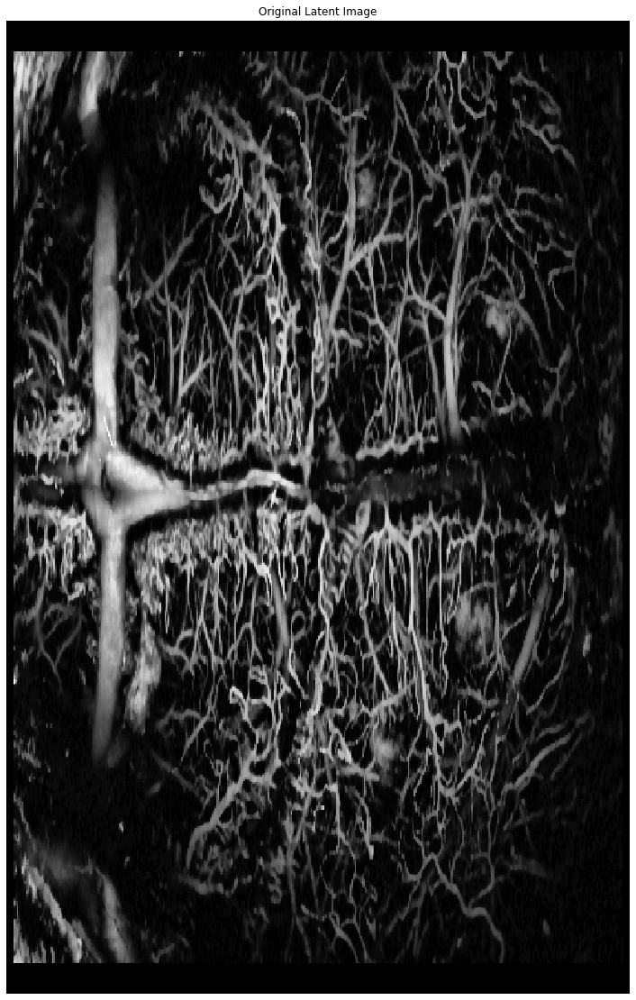

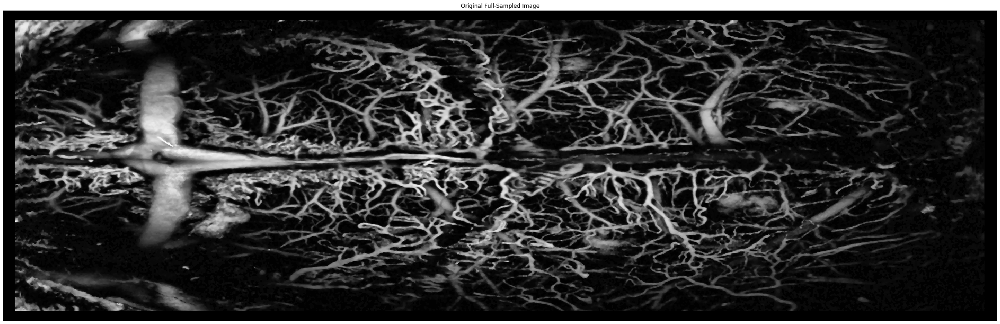

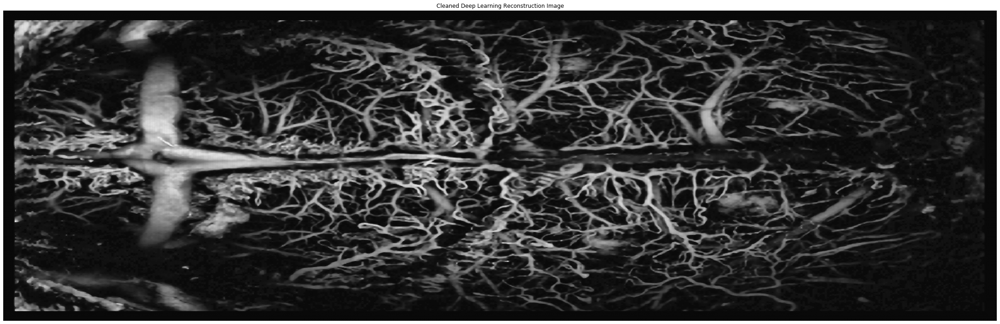

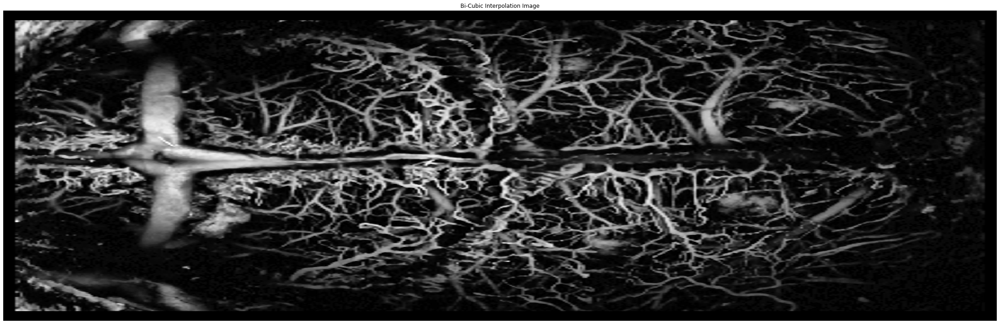

---------------------------------------
##########LIST OF STATISTICS:##########
---------------------------------------
COMPARISON OF PSNR:
Deep Learning: 28.601418
Bicubic Interp: 27.659435
COMPARISON OF SSIM:
Deep Learning: 0.77107257
Bicubic Interp: 0.89156836
COMPARISON OF MEAN ABSOLUTE ERROR:
Deep Learning: 0.031925052
Bicubic Interp: 0.02082931
COMPARISON OF MEAN SQUARED ERROR:
Deep Learning: 0.0013799334
Bicubic Interp: 0.0017141799
COMPARISON OF KL DIVERGENCE:
Deep Learning: -0.010370254
Bicubic Interp: 0.0057026306
COMPARISON OF MEAN SQUARED LOGARITHMIC ERROR:
Deep Learning: 0.0010532577
Bicubic Interp: 0.0010298395
COMPARISON OF LOG COSH ERROR:
Deep Learning: 0.0006891586
Bicubic Interp: 0.00085267646
COMPARISON OF POISSON LOSS:
Deep Learning: 0.34663278
Bicubic Interp: 0.34089464


In [134]:
dir_name = 'patchwork_test'
#saved_model = best_unet_model
file_list = os.listdir(dir_name)   
filename = os.fsdecode(file_list[0])
filepath = os.path.join(dir_name, filename)
print('Directory: ' + filepath)
#filepath = 'testing/input/reslt_OR_7 (2)_index0_center_crop.tif'
orig_img = np.array(imageio.imread(filepath))
full_samp_img = exposure.rescale_intensity(orig_img[...,0], in_range='image', out_range=(0.0,1.0))
'''
# If using color images
if len(img.shape)>2:
    img = np.mean(img, axis = 2)
'''
# Recover Latent Image:
downsampling_ratio = [1,5]
latent_image = np.zeros((int(np.ceil(full_samp_img.shape[0]/downsampling_ratio[0])), 
                         int(np.ceil(full_samp_img.shape[1]/downsampling_ratio[1]))))
i_count = 0
for i in range(0, full_samp_img.shape[0], downsampling_ratio[0]):
    j_count = 0
    for j in range(0, full_samp_img.shape[1], downsampling_ratio[1]):
        latent_image[i_count, j_count] = full_samp_img[i, j]
        if j%downsampling_ratio[1]==0:
            j_count += 1
    if i%downsampling_ratio[0]==0:
        i_count += 1
figsize = (15,15)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(latent_image, cmap = 'gray')
plt.title('Original Latent Image')
plt.show()

figsize = (30,30)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(full_samp_img, cmap = 'gray')
plt.title('Original Full-Sampled Image')
plt.show()
deep_image = apply_model_patchwork(saved_model, down_image = latent_image, downsampling_ratio = [1,5], 
                                   downsampling_axis = 'both', shape_for_model = (128,128), 
                                   buffer = 20, output_shape = full_samp_img.shape)
# figsize = (27,27)
# fig = plt.figure(figsize=figsize)
# ax = fig.add_axes([0, 0, 1, 1])
# ax.axis('off')
# ax.imshow(deep_image, cmap = 'gray')
# plt.title('Deep Learning Reconstruction Image')
# plt.show()

#deep_image = remove_peak(deep_image, num_std = 4)
figsize = (30,30)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(deep_image, cmap = 'gray')
plt.title('Cleaned Deep Learning Reconstruction Image')
plt.show()

# COMPARISON TO INTERPOLATION:
# From https://scikit-image.org/docs/dev/api/skimage.transform.html#skimage.transform.warp
# and https://scikit-image.org/docs/dev/api/skimage.transform.html#skimage.transform.resize
downsampling_ratio = [1,5]
interp_img = skimage.transform.resize(latent_image, output_shape=full_samp_img.shape, 
                                      order=3, mode='reflect', cval=0, clip=True, preserve_range=True, anti_aliasing=True, 
                                      anti_aliasing_sigma=None)
figsize = (30,30)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(interp_img, cmap = 'gray')
plt.title('Bi-Cubic Interpolation Image')
plt.show()

# Quantitative Measurements
from model_utils import PSNR
from model_utils import SSIM
from model_utils import KLDivergence
#from model_utils import TV
deep_image = deep_image[..., None]
deep_image = tf.image.convert_image_dtype(deep_image[None, ...], tf.float32)
interp_img = interp_img[..., None]
interp_img = tf.image.convert_image_dtype(interp_img[None, ...], tf.float32)
full_samp_img = full_samp_img[..., None]
full_samp_img = tf.image.convert_image_dtype(full_samp_img[None, ...], tf.float32)
print('---------------------------------------')
print('##########LIST OF STATISTICS:##########')
print('---------------------------------------')
print('COMPARISON OF PSNR:')
print('Deep Learning: ' + str(PSNR(full_samp_img, deep_image).numpy()[0]))
print('Bicubic Interp: ' + str(PSNR(full_samp_img, interp_img).numpy()[0]))
print('COMPARISON OF SSIM:')
print('Deep Learning: ' + str(SSIM(full_samp_img, deep_image).numpy()[0]))
print('Bicubic Interp: ' + str(SSIM(full_samp_img, interp_img).numpy()[0]))
print('COMPARISON OF MEAN ABSOLUTE ERROR:')
MAE = tf.keras.losses.MeanAbsoluteError()
print('Deep Learning: ' + str(MAE(full_samp_img, deep_image).numpy()))
print('Bicubic Interp: ' + str(MAE(full_samp_img, interp_img).numpy()))
print('COMPARISON OF MEAN SQUARED ERROR:')
MSE = tf.keras.losses.MeanSquaredError()
print('Deep Learning: ' + str(MSE(full_samp_img, deep_image).numpy()))
print('Bicubic Interp: ' + str(MSE(full_samp_img, interp_img).numpy()))
#print('COMPARISON OF TOTAL VARIATION:')
#print('Deep Learning: ' + str(TV(full_samp_img, deep_image).numpy()))
#print('Bicubic Interp: ' + str(TV(full_samp_img, interp_img).numpy()))
print('COMPARISON OF KL DIVERGENCE:')
print('Deep Learning: ' + str(KLDivergence(full_samp_img, deep_image).numpy()))
print('Bicubic Interp: ' + str(KLDivergence(full_samp_img, interp_img).numpy()))
print('COMPARISON OF MEAN SQUARED LOGARITHMIC ERROR:')
MSLE = tf.keras.losses.MeanSquaredLogarithmicError()
print('Deep Learning: ' + str(MSLE(full_samp_img, deep_image).numpy()))
print('Bicubic Interp: ' + str(MSLE(full_samp_img, interp_img).numpy()))
print('COMPARISON OF LOG COSH ERROR:')
LCOSH = tf.keras.losses.LogCosh()
print('Deep Learning: ' + str(LCOSH(full_samp_img, deep_image).numpy()))
print('Bicubic Interp: ' + str(LCOSH(full_samp_img, interp_img).numpy()))
print('COMPARISON OF POISSON LOSS:')
PL = tf.keras.losses.Poisson()
print('Deep Learning: ' + str(PL(full_samp_img, deep_image).numpy()))
print('Bicubic Interp: ' + str(PL(full_samp_img, interp_img).numpy()))

## Cropped Images:

Directory: patchwork_test\reslt_OR_9 (5)_index0_pad.tif


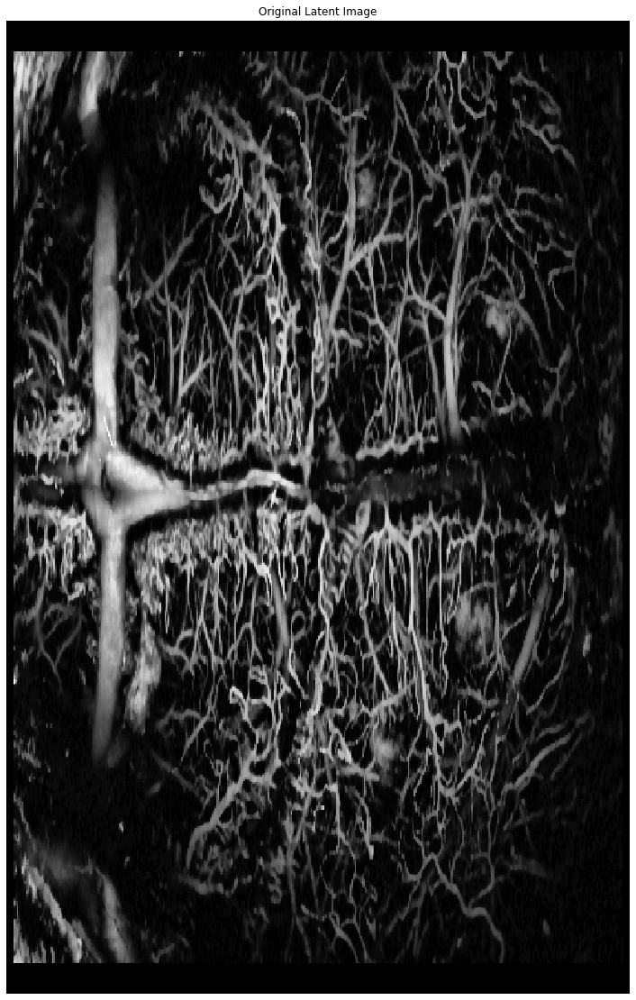

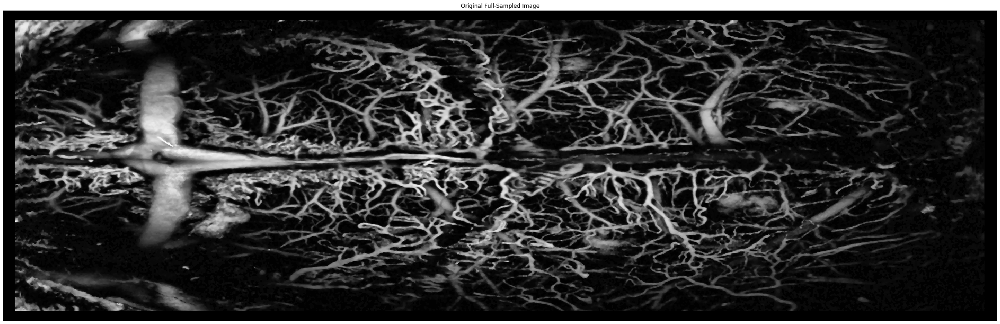

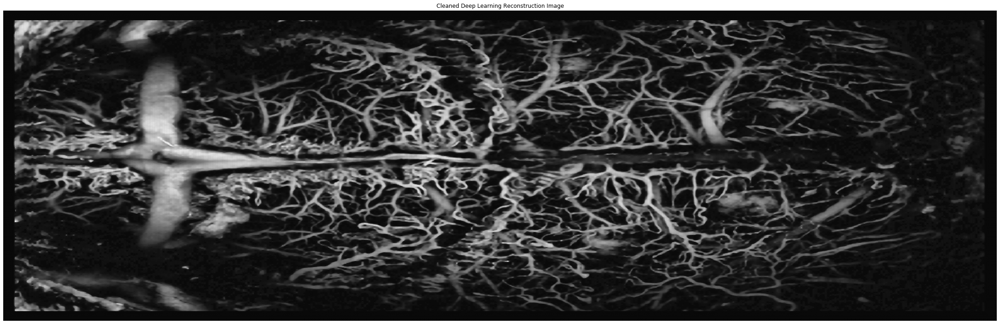

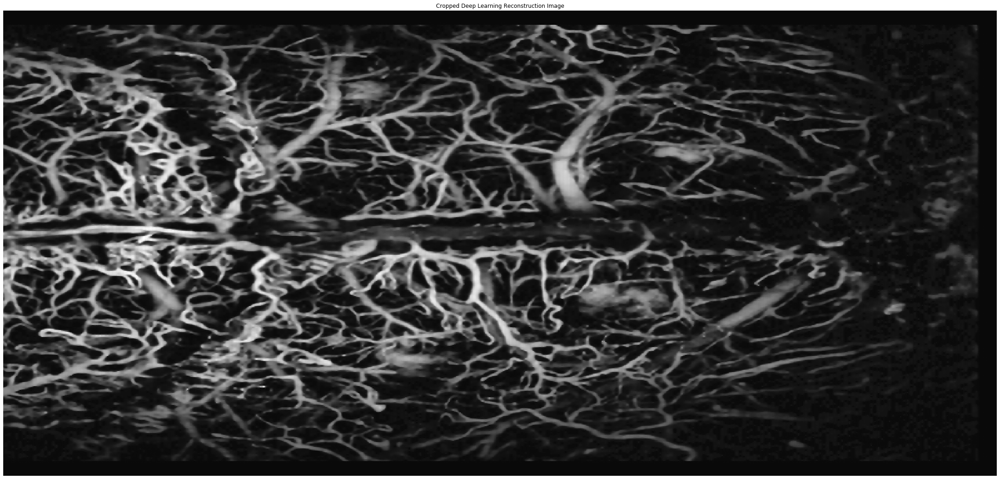

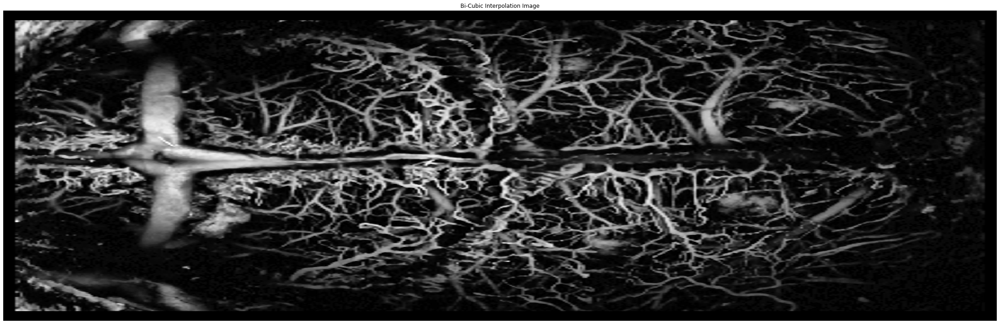

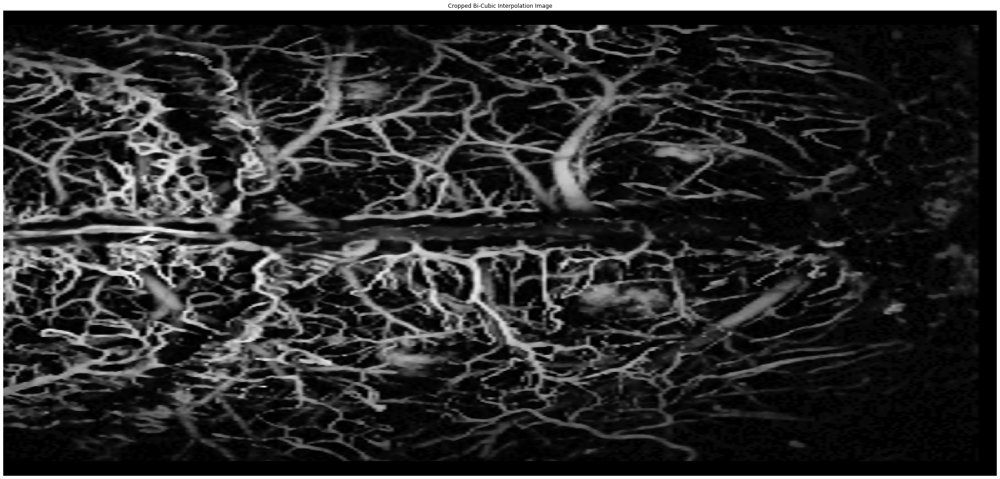

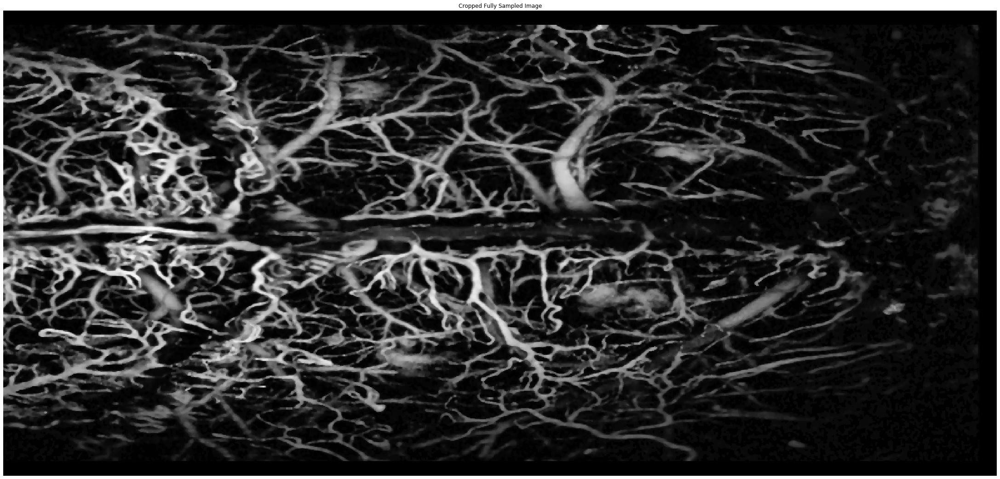

---------------------------------------
##########LIST OF STATISTICS:##########
---------------------------------------
COMPARISON OF PSNR:
Deep Learning: 28.484373
Bicubic Interp: 27.880598
COMPARISON OF SSIM:
Deep Learning: 0.77131987
Bicubic Interp: 0.90091896
COMPARISON OF MEAN ABSOLUTE ERROR:
Deep Learning: 0.03236038
Bicubic Interp: 0.019941568
COMPARISON OF MEAN SQUARED ERROR:
Deep Learning: 0.0014176286
Bicubic Interp: 0.0016290708
COMPARISON OF KL DIVERGENCE:
Deep Learning: -0.010999312
Bicubic Interp: 0.0056334087
COMPARISON OF MEAN SQUARED LOGARITHMIC ERROR:
Deep Learning: 0.0010860079
Bicubic Interp: 0.0009880764
COMPARISON OF LOG COSH ERROR:
Deep Learning: 0.00070804305
Bicubic Interp: 0.0008104175
COMPARISON OF POISSON LOSS:
Deep Learning: 0.33598801
Bicubic Interp: 0.3301524


In [135]:
dir_name = 'patchwork_test'
#saved_model = best_unet_model
file_list = os.listdir(dir_name)   
filename = os.fsdecode(file_list[0])
filepath = os.path.join(dir_name, filename)
print('Directory: ' + filepath)
#filepath = 'testing/input/reslt_OR_7 (2)_index0_center_crop.tif'
orig_img = np.array(imageio.imread(filepath))
full_samp_img = exposure.rescale_intensity(orig_img[...,0], in_range='image', out_range=(0.0,1.0))
'''
# If using color images
if len(img.shape)>2:
    img = np.mean(img, axis = 2)
'''
# Recover Latent Image:
downsampling_ratio = [1,5]
latent_image = np.zeros((int(np.ceil(full_samp_img.shape[0]/downsampling_ratio[0])), 
                         int(np.ceil(full_samp_img.shape[1]/downsampling_ratio[1]))))
i_count = 0
for i in range(0, full_samp_img.shape[0], downsampling_ratio[0]):
    j_count = 0
    for j in range(0, full_samp_img.shape[1], downsampling_ratio[1]):
        latent_image[i_count, j_count] = full_samp_img[i, j]
        if j%downsampling_ratio[1]==0:
            j_count += 1
    if i%downsampling_ratio[0]==0:
        i_count += 1
figsize = (15,15)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(latent_image, cmap = 'gray')
plt.title('Original Latent Image')
plt.show()

figsize = (30,30)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(full_samp_img, cmap = 'gray')
plt.title('Original Full-Sampled Image')
plt.show()
deep_image = apply_model_patchwork(saved_model, down_image = latent_image, downsampling_ratio = [1,5], 
                                   downsampling_axis = 'both', shape_for_model = (128,128), 
                                   buffer = 20, output_shape = full_samp_img.shape)
# figsize = (27,27)
# fig = plt.figure(figsize=figsize)
# ax = fig.add_axes([0, 0, 1, 1])
# ax.axis('off')
# ax.imshow(deep_image, cmap = 'gray')
# plt.title('Deep Learning Reconstruction Image')
# plt.show()

#deep_image = remove_peak(deep_image, num_std = 4)
figsize = (30,30)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(deep_image, cmap = 'gray')
plt.title('Cleaned Deep Learning Reconstruction Image')
plt.show()

# Cropped DL Image:
deep_image = deep_image[:,deep_image.shape[1]//3:]
figsize = (30,30)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(deep_image, cmap = 'gray')
plt.title('Cropped Deep Learning Reconstruction Image')
plt.show()

# COMPARISON TO INTERPOLATION:
# From https://scikit-image.org/docs/dev/api/skimage.transform.html#skimage.transform.warp
# and https://scikit-image.org/docs/dev/api/skimage.transform.html#skimage.transform.resize
downsampling_ratio = [1,5]
interp_img = skimage.transform.resize(latent_image, output_shape=full_samp_img.shape, 
                                      order=3, mode='reflect', cval=0, clip=True, preserve_range=True, anti_aliasing=True, 
                                      anti_aliasing_sigma=None)
figsize = (30,30)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(interp_img, cmap = 'gray')
plt.title('Bi-Cubic Interpolation Image')
plt.show()

# Cropped Interpolation Image:
interp_img = interp_img[:,interp_img.shape[1]//3:]
figsize = (30,30)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(interp_img, cmap = 'gray')
plt.title('Cropped Bi-Cubic Interpolation Image')
plt.show()

# Cropped Fully Sampled Image:
full_samp_img = full_samp_img[:,full_samp_img.shape[1]//3:]
figsize = (30,30)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(full_samp_img, cmap = 'gray')
plt.title('Cropped Fully Sampled Image')
plt.show()

# Quantitative Measurements
from model_utils import PSNR
from model_utils import SSIM
from model_utils import KLDivergence
#from model_utils import TV
deep_image = deep_image[..., None]
deep_image = tf.image.convert_image_dtype(deep_image[None, ...], tf.float32)
interp_img = interp_img[..., None]
interp_img = tf.image.convert_image_dtype(interp_img[None, ...], tf.float32)
full_samp_img = full_samp_img[..., None]
full_samp_img = tf.image.convert_image_dtype(full_samp_img[None, ...], tf.float32)
print('---------------------------------------')
print('##########LIST OF STATISTICS:##########')
print('---------------------------------------')
print('COMPARISON OF PSNR:')
print('Deep Learning: ' + str(PSNR(full_samp_img, deep_image).numpy()[0]))
print('Bicubic Interp: ' + str(PSNR(full_samp_img, interp_img).numpy()[0]))
print('COMPARISON OF SSIM:')
print('Deep Learning: ' + str(SSIM(full_samp_img, deep_image).numpy()[0]))
print('Bicubic Interp: ' + str(SSIM(full_samp_img, interp_img).numpy()[0]))
print('COMPARISON OF MEAN ABSOLUTE ERROR:')
MAE = tf.keras.losses.MeanAbsoluteError()
print('Deep Learning: ' + str(MAE(full_samp_img, deep_image).numpy()))
print('Bicubic Interp: ' + str(MAE(full_samp_img, interp_img).numpy()))
print('COMPARISON OF MEAN SQUARED ERROR:')
MSE = tf.keras.losses.MeanSquaredError()
print('Deep Learning: ' + str(MSE(full_samp_img, deep_image).numpy()))
print('Bicubic Interp: ' + str(MSE(full_samp_img, interp_img).numpy()))
#print('COMPARISON OF TOTAL VARIATION:')
#print('Deep Learning: ' + str(TV(full_samp_img, deep_image).numpy()))
#print('Bicubic Interp: ' + str(TV(full_samp_img, interp_img).numpy()))
print('COMPARISON OF KL DIVERGENCE:')
print('Deep Learning: ' + str(KLDivergence(full_samp_img, deep_image).numpy()))
print('Bicubic Interp: ' + str(KLDivergence(full_samp_img, interp_img).numpy()))
print('COMPARISON OF MEAN SQUARED LOGARITHMIC ERROR:')
MSLE = tf.keras.losses.MeanSquaredLogarithmicError()
print('Deep Learning: ' + str(MSLE(full_samp_img, deep_image).numpy()))
print('Bicubic Interp: ' + str(MSLE(full_samp_img, interp_img).numpy()))
print('COMPARISON OF LOG COSH ERROR:')
LCOSH = tf.keras.losses.LogCosh()
print('Deep Learning: ' + str(LCOSH(full_samp_img, deep_image).numpy()))
print('Bicubic Interp: ' + str(LCOSH(full_samp_img, interp_img).numpy()))
print('COMPARISON OF POISSON LOSS:')
PL = tf.keras.losses.Poisson()
print('Deep Learning: ' + str(PL(full_samp_img, deep_image).numpy()))
print('Bicubic Interp: ' + str(PL(full_samp_img, interp_img).numpy()))

# Creating Training Data where Downsampling is Performed and then using Interpolation as Pre-Reconstruction

## Extracting Fully Sampled Data from Previous "Data" Folder to Create Folders With Different Downsampling Ratios While Maintaining the Same Data Split

In [10]:
def extract_full_samp_and_retain_file_struct(input_dir, output_dir, delete_previous = True):
    '''
    This function loops through an input directory and converts each file to undo the
    function "pad_img_and_add_down_channel." The modified image is then saved into the 
    output directory.
    '''
    print('Starting Extraction...')
    abs_input_dir = os.path.join(os.getcwd(), input_dir)
    folder_list = os.listdir(abs_input_dir)
    abs_output_dir = os.path.join(os.getcwd(), output_dir)
    if not os.path.exists(abs_output_dir):
        os.mkdir(abs_output_dir)
    elif delete_previous == True:
        shutil.rmtree(abs_output_dir)
        os.mkdir(abs_output_dir)
    for folder in folder_list:
        if folder != '.ipynb_checkpoints':
            folder_dir = os.path.join(abs_input_dir, folder)
            folder_dir = os.path.join(folder_dir, 'input')
            file_list = os.listdir(folder_dir)
            new_dir = os.path.join(abs_output_dir, folder)
            if not os.path.exists(new_dir):
                os.mkdir(new_dir)
                new_dir = os.path.join(new_dir, 'input')
                os.mkdir(new_dir)
            for file in file_list:
                filename = os.fsdecode(file)
                filepath = os.path.join(folder_dir, filename)
                if filepath.endswith('.npy'):
                    array = np.load(filepath)
                else:
                    array = imageio.imread(filepath)
                if len(array.shape) == 3:
                    array = array[..., 0] # First Index Represents Fully Sampled Image
                else: 
                    print('Error: please only input data directory that has already been formatted using function \"standardize_dir\"')
                new_filepath = os.path.join(new_dir, filename)
                if filepath.endswith('.npy'):
                    new_filepath = Path(new_filepath)
                    np.save(new_filepath, array, allow_pickle=True, fix_imports=True)
                else:
                    new_filepath = Path(new_filepath)
                    imageio.imwrite(new_filepath, array)
    print('Ending Extraction !!!')

In [11]:
input_dir = 'data'
output_dir = 'data_1'
extract_full_samp_and_retain_file_struct(input_dir, output_dir, delete_previous = True)

Starting Extraction...
Ending Extraction !!!


## Going Through Directory to Downsample and then Partilly Reconstruct Using Interpolation

In [12]:
# Import Statements:
import standardize_dir_with_interp_utils
from standardize_dir_with_interp_utils import pad_img_and_add_interp_down_channel
from standardize_dir_with_interp_utils import standardize_dir_with_interp

In [13]:
input_dir = 'data_1/train/input'
STANDARD_IMAGE_SHAPE = (128,128,1)
total_train_image_pool = standardize_dir_with_interp(input_dir = input_dir, downsample_axis = 'both', downsample_ratio = [3,7], 
                                                     standard_shape = STANDARD_IMAGE_SHAPE, file_format = '.tif', add_pad_title = False)
print('total_train_image_pool = ' + str(total_train_image_pool))

total_train_image_pool = 235


In [14]:
input_dir = 'data_1/val/input'
STANDARD_IMAGE_SHAPE = (128,128,1)
total_val_image_pool = standardize_dir_with_interp(input_dir = input_dir, downsample_axis = 'both', downsample_ratio = [3,7], 
                                                   standard_shape = STANDARD_IMAGE_SHAPE, file_format = '.tif', add_pad_title = False)
print('total_val_image_pool = ' + str(total_val_image_pool))

total_val_image_pool = 30


In [15]:
input_dir = 'data_1/test/input'
STANDARD_IMAGE_SHAPE = (128,128,1)
total_test_image_pool = standardize_dir_with_interp(input_dir = input_dir, downsample_axis = 'both', downsample_ratio = [3,7], 
                                                    standard_shape = STANDARD_IMAGE_SHAPE, file_format = '.tif', add_pad_title = False)
print('total_test_image_pool = ' + str(total_test_image_pool))

total_test_image_pool = 29


## Creating Test Images for Interpolation Pre-Reconstruction Results

In [4]:
# Import Statements:
import patchwork_alg_interp
from patchwork_alg_interp import expand_image_with_interp
from patchwork_alg_interp import apply_model_patchwork_with_interp
from patchwork_alg_interp import remove_peak

Directory: patchwork_test\reslt_OR_9 (5)_index0_pad.tif
(128, 205)


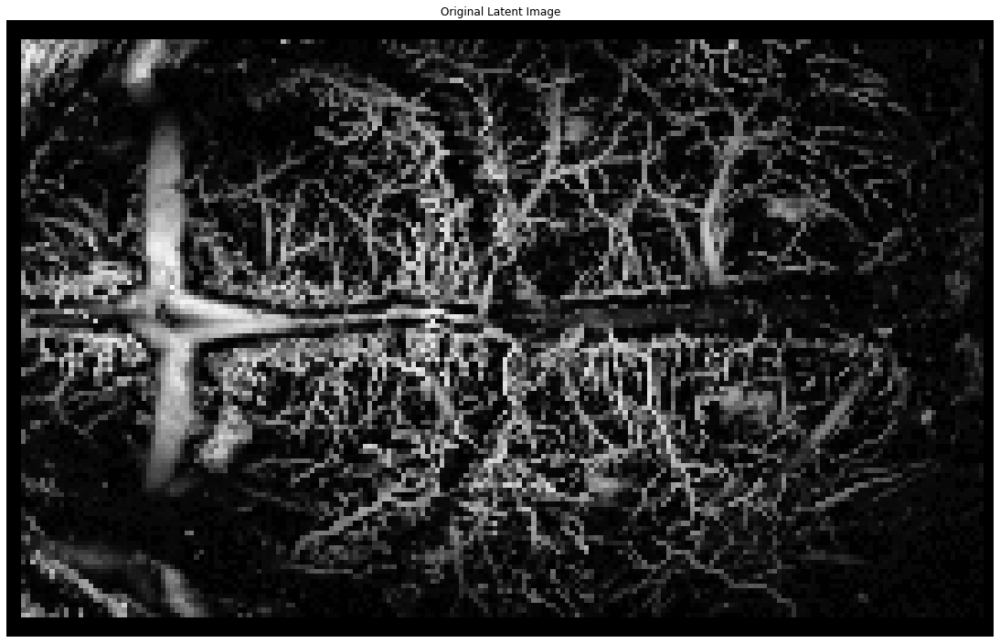

(640, 2048)


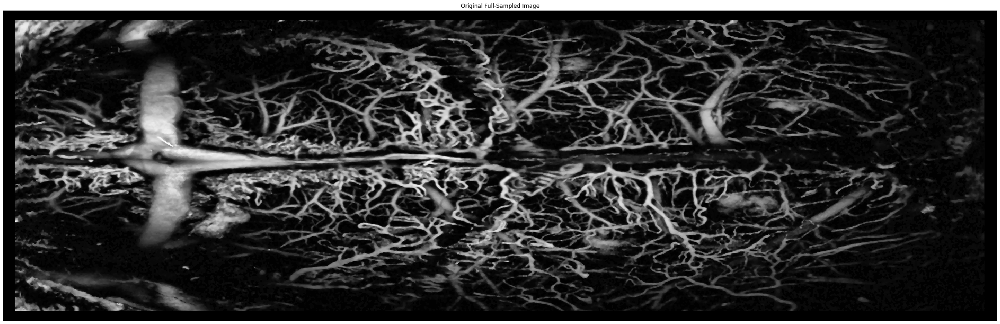

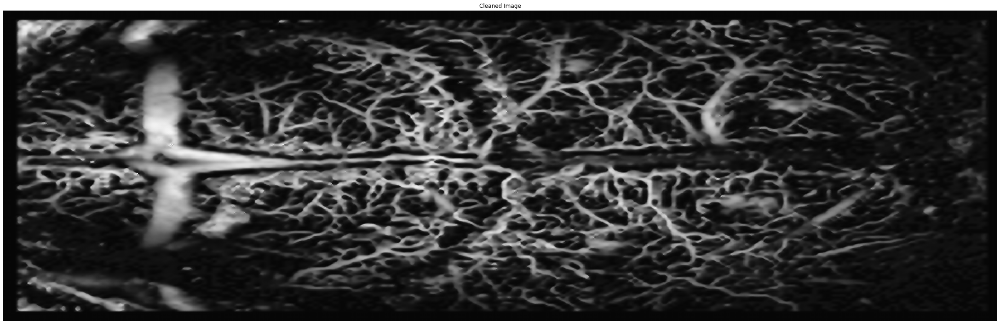

(640, 1366)


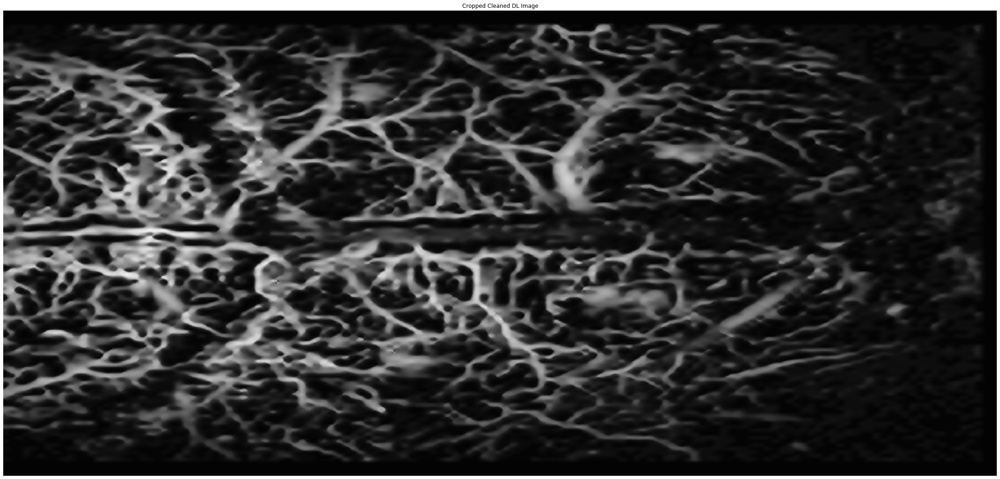

(640, 2048)


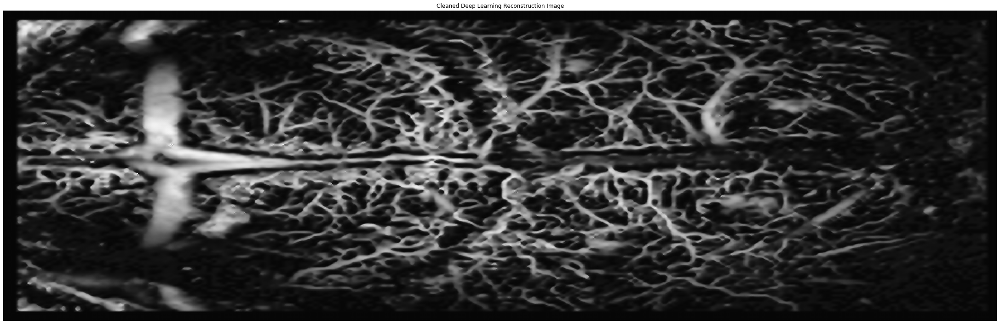

(640, 1366)


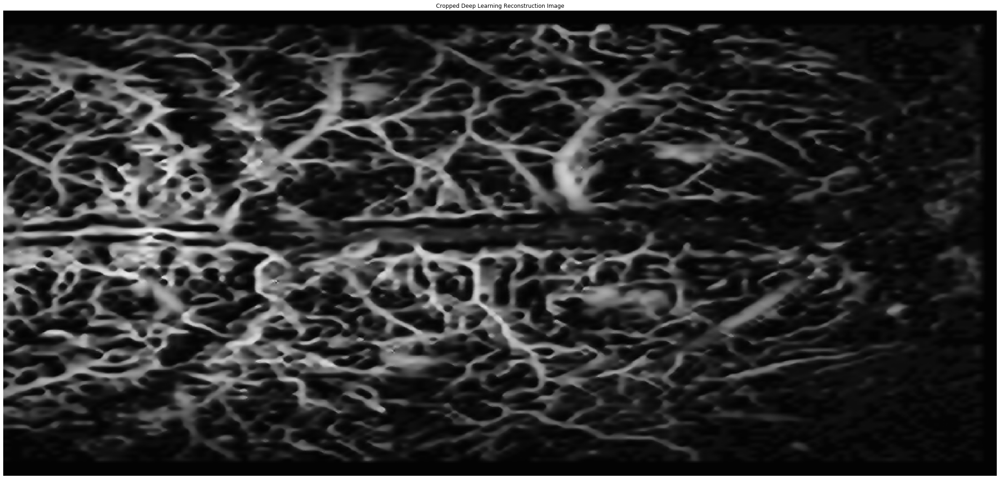

(640, 2048)


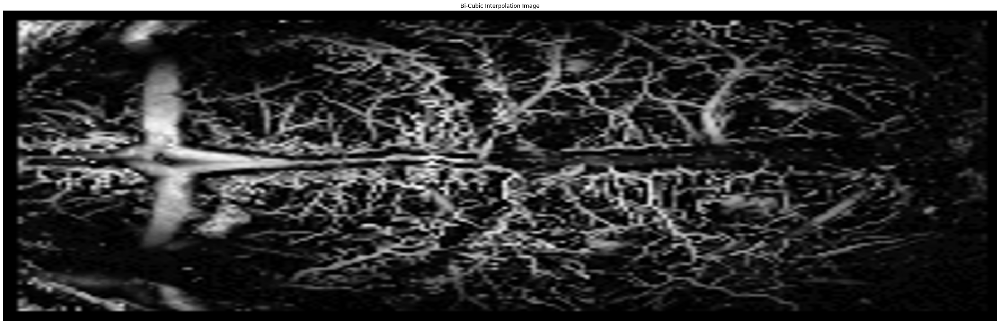

(640, 1366)


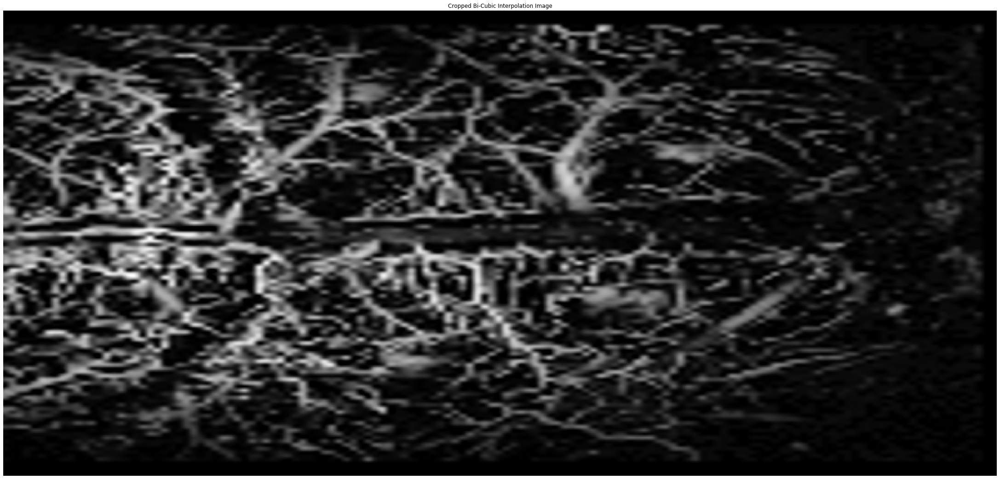

(640, 1366)


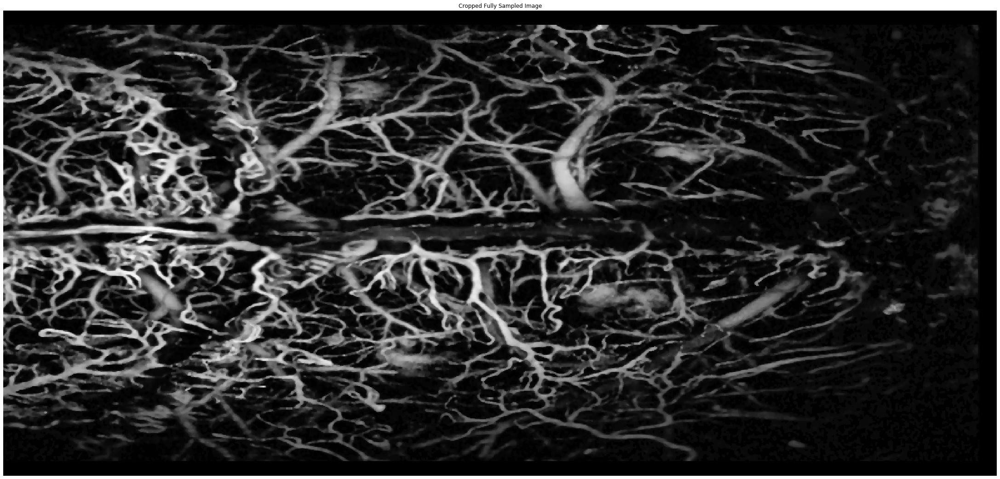

---------------------------------------
##########LIST OF STATISTICS:##########
---------------------------------------
COMPARISON OF PSNR:
Deep Learning: 18.770552
Bicubic Interp: 18.550354
COMPARISON OF SSIM:
Deep Learning: 0.43605283
Bicubic Interp: 0.50055146
COMPARISON OF MEAN ABSOLUTE ERROR:
Deep Learning: 0.07649027
Bicubic Interp: 0.07101627
COMPARISON OF MEAN SQUARED ERROR:
Deep Learning: 0.013272255
Bicubic Interp: 0.013962543
COMPARISON OF KL DIVERGENCE:
Deep Learning: 0.00573838
Bicubic Interp: 0.045570176
COMPARISON OF MEAN SQUARED LOGARITHMIC ERROR:
Deep Learning: 0.008224586
Bicubic Interp: 0.008533811
COMPARISON OF LOG COSH ERROR:
Deep Learning: 0.0065312567
Bicubic Interp: 0.0068638343
COMPARISON OF POISSON LOSS:
Deep Learning: 0.36053094
Bicubic Interp: 0.3711381


In [18]:
dir_name = 'patchwork_test'
#saved_model = best_unet_model
#saved_model = unet_model
file_list = os.listdir(dir_name)   
filename = os.fsdecode(file_list[0])
filepath = os.path.join(dir_name, filename)
print('Directory: ' + filepath)
#filepath = 'testing/input/reslt_OR_7 (2)_index0_center_crop.tif'
orig_img = np.array(imageio.imread(filepath))
full_samp_img = exposure.rescale_intensity(orig_img[...,0], in_range='image', out_range=(0.0,1.0))
'''
# If using color images
if len(img.shape)>2:
    img = np.mean(img, axis = 2)
'''
# Recover Latent Image:
downsampling_ratio = [5,10]
latent_image = np.zeros((int(np.ceil(full_samp_img.shape[0]/downsampling_ratio[0])), 
                         int(np.ceil(full_samp_img.shape[1]/downsampling_ratio[1]))))
i_count = 0
for i in range(0, full_samp_img.shape[0], downsampling_ratio[0]):
    j_count = 0
    for j in range(0, full_samp_img.shape[1], downsampling_ratio[1]):
        latent_image[i_count, j_count] = full_samp_img[i, j]
        if j%downsampling_ratio[1]==0:
            j_count += 1
    if i%downsampling_ratio[0]==0:
        i_count += 1
print(latent_image.shape)
figsize = (15,15)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(latent_image, cmap = 'gray')
plt.title('Original Latent Image')
plt.show()

print(full_samp_img.shape)
figsize = (30,30)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(full_samp_img, cmap = 'gray')
plt.title('Original Full-Sampled Image')
plt.show()
deep_image = apply_model_patchwork_with_interp(saved_model2, down_image = latent_image, downsampling_ratio = downsampling_ratio, 
                                               downsampling_axis = 'both', shape_for_model = (128,128), 
                                               buffer = 20, output_shape = full_samp_img.shape)
clean = skimage.img_as_float(deep_image)
p1, p2 = np.percentile(clean, (0.75, 99.25))
mask = exposure.rescale_intensity(clean, in_range=(p1, p2))
figsize = (30,30)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(clean, cmap = 'gray')
plt.title('Cleaned Image')
plt.show()

# Cropped Cleaned DL Image:
clean = clean[:,clean.shape[1]//3:]
#deep_image = remove_peak(deep_image, num_std = 4.5)
print(clean.shape)
figsize = (30,30)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(clean, cmap = 'gray')
plt.title('Cropped Cleaned DL Image')
plt.show()

# figsize = (27,27)
# fig = plt.figure(figsize=figsize)
# ax = fig.add_axes([0, 0, 1, 1])
# ax.axis('off')
# ax.imshow(deep_image, cmap = 'gray')
# plt.title('Deep Learning Reconstruction Image')
# plt.show()

print(deep_image.shape)
figsize = (30,30)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(deep_image, cmap = 'gray')
plt.title('Cleaned Deep Learning Reconstruction Image')
plt.show()

# Cropped DL Image:
deep_image = deep_image[:,deep_image.shape[1]//3:]
#deep_image = remove_peak(deep_image, num_std = 4.5)
print(deep_image.shape)
figsize = (30,30)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(deep_image, cmap = 'gray')
plt.title('Cropped Deep Learning Reconstruction Image')
plt.show()

# COMPARISON TO INTERPOLATION:
# From https://scikit-image.org/docs/dev/api/skimage.transform.html#skimage.transform.warp
# and https://scikit-image.org/docs/dev/api/skimage.transform.html#skimage.transform.resize
interp_img = skimage.transform.resize(latent_image, output_shape=full_samp_img.shape, 
                                      order=3, mode='reflect', cval=0, clip=True, preserve_range=True, anti_aliasing=True, 
                                      anti_aliasing_sigma=None)
print(interp_img.shape)
figsize = (30,30)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(interp_img, cmap = 'gray')
plt.title('Bi-Cubic Interpolation Image')
plt.show()

# Cropped Interpolation Image:
interp_img = interp_img[:,interp_img.shape[1]//3:]
print(interp_img.shape)
figsize = (30,30)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(interp_img, cmap = 'gray')
plt.title('Cropped Bi-Cubic Interpolation Image')
plt.show()

# Cropped Fully Sampled Image:
full_samp_img = full_samp_img[:,full_samp_img.shape[1]//3:]
print(full_samp_img.shape)
figsize = (30,30)
fig = plt.figure(figsize=figsize)
ax = fig.add_axes([0, 0, 1, 1])
ax.axis('off')
ax.imshow(full_samp_img, cmap = 'gray')
plt.title('Cropped Fully Sampled Image')
plt.show()

# Quantitative Measurements
from model_utils import PSNR
from model_utils import SSIM
from model_utils import KLDivergence
#from model_utils import TV
deep_image = deep_image[..., None]
deep_image = tf.image.convert_image_dtype(deep_image[None, ...], tf.float32)
interp_img = interp_img[..., None]
interp_img = tf.image.convert_image_dtype(interp_img[None, ...], tf.float32)
full_samp_img = full_samp_img[..., None]
full_samp_img = tf.image.convert_image_dtype(full_samp_img[None, ...], tf.float32)
print('---------------------------------------')
print('##########LIST OF STATISTICS:##########')
print('---------------------------------------')
print('COMPARISON OF PSNR:')
print('Deep Learning: ' + str(PSNR(full_samp_img, deep_image).numpy()[0]))
print('Bicubic Interp: ' + str(PSNR(full_samp_img, interp_img).numpy()[0]))
print('COMPARISON OF SSIM:')
print('Deep Learning: ' + str(SSIM(full_samp_img, deep_image).numpy()[0]))
print('Bicubic Interp: ' + str(SSIM(full_samp_img, interp_img).numpy()[0]))
print('COMPARISON OF MEAN ABSOLUTE ERROR:')
MAE = tf.keras.losses.MeanAbsoluteError()
print('Deep Learning: ' + str(MAE(full_samp_img, deep_image).numpy()))
print('Bicubic Interp: ' + str(MAE(full_samp_img, interp_img).numpy()))
print('COMPARISON OF MEAN SQUARED ERROR:')
MSE = tf.keras.losses.MeanSquaredError()
print('Deep Learning: ' + str(MSE(full_samp_img, deep_image).numpy()))
print('Bicubic Interp: ' + str(MSE(full_samp_img, interp_img).numpy()))
#print('COMPARISON OF TOTAL VARIATION:')
#print('Deep Learning: ' + str(TV(full_samp_img, deep_image).numpy()))
#print('Bicubic Interp: ' + str(TV(full_samp_img, interp_img).numpy()))
print('COMPARISON OF KL DIVERGENCE:')
print('Deep Learning: ' + str(KLDivergence(full_samp_img, deep_image).numpy()))
print('Bicubic Interp: ' + str(KLDivergence(full_samp_img, interp_img).numpy()))
print('COMPARISON OF MEAN SQUARED LOGARITHMIC ERROR:')
MSLE = tf.keras.losses.MeanSquaredLogarithmicError()
print('Deep Learning: ' + str(MSLE(full_samp_img, deep_image).numpy()))
print('Bicubic Interp: ' + str(MSLE(full_samp_img, interp_img).numpy()))
print('COMPARISON OF LOG COSH ERROR:')
LCOSH = tf.keras.losses.LogCosh()
print('Deep Learning: ' + str(LCOSH(full_samp_img, deep_image).numpy()))
print('Bicubic Interp: ' + str(LCOSH(full_samp_img, interp_img).numpy()))
print('COMPARISON OF POISSON LOSS:')
PL = tf.keras.losses.Poisson()
print('Deep Learning: ' + str(PL(full_samp_img, deep_image).numpy()))
print('Bicubic Interp: ' + str(PL(full_samp_img, interp_img).numpy()))

# Scratchpad

In [ ]:
data = np.empty(1)
print(data.shape)
dir = 'converted_data'
iter = 0
for file in os.listdir(dir):
        filename = os.fsdecode(file)
        temp = np.load(dir+'/'+filename)
        temp = temp[..., None]
        print(temp.shape)
        data[iter, :, :, :] = temp
        iter += 1 

In [ ]:
im = Image.open('./data/train/190304_brain 1_Image0.tif')

In [ ]:
im.show()

In [ ]:
imarray = np.array(im)*255

In [ ]:
np.max(imarray)

In [ ]:
im = Image.fromarray(imarray)

In [ ]:
im.show()

In [ ]:
d = next(train_generator)
print(d[0][0][0][0])

In [ ]:
print(train_dir)

In [ ]:
W = np.ones((5,5))*2
inp = np.ones((5, 5))*3
inp = inp[None, ...]
out = np.multiply(W, inp)
print(out.shape)
print(inp.shape)

In [ ]:
print(out[2:])

In [ ]:
A = np.ones((800,1800, 5))
A_avg = np.sum(A, axis = 2)
print(np.min(A_avg))

In [ ]:
array_dict = {'key1': np.zeros((10,10,10,10)), 'key2': 20, 'map_530': 25, 'map_all': 30}
search_keys = ['map_530', 'key1']
#filtered_dict = dict(filter(lambda item: search_key[0] search_key[1] in item[0], array_dict.items()))
filtered_dict = {}
for i in range(len(search_keys)):
    search_key = search_keys[i]
    if search_key in array_dict:
        filtered_dict[search_key] = array_dict[search_key]

In [ ]:
print(filtered_dict)

In [ ]:
print(len(filtered_dict))

In [37]:
A = np.random.randn(1000,2000)
B = exposure.rescale_intensity(A, in_range='image', out_range=(0,1))
print(np.max(A))
print(np.mean(B))

5.037808862416426
0.47774941874803667


In [150]:
A = np.zeros((10,10))
B = np.ones((10,10))
C = np.array([A, B])
print(C.shape)
D = np.hstack(C)
print(D)
E = np.concatenate(D, axis = 0)
print(E.shape)
print(E)

(2, 10, 10)
[[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]]
(200,)
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 1. 1. 1. 1. 

In [67]:
print(int(tf.random.uniform(shape=[1], minval = 0, maxval = 5, dtype=tf.float32).numpy()[0]))

0


In [187]:
A = [1,2,3,4,5]
B = [1,2,3,4,5]
random.seed(a=1)
random.shuffle(A)
random.shuffle(B)
print(A)
print(B)

[3, 4, 5, 1, 2]
[1, 3, 2, 5, 4]


In [178]:
a = range(6)
for i in a:
    print(i)

0
1
2
3
4
5


In [317]:
print(1%10)

1


In [11]:
np.nan*0

nan

In [20]:
A = np.array(0)
print(len(A.shape))

0


In [4]:
print(1%1)

0
